In [1]:
import cv2
import os
from PIL import Image
import numpy as np
import matplotlib.pyplot as plt
import random

In [2]:
image_bank = r"C:\Users\u344260\pythonvenvs\boatBuilding\rawPhotos"

for root, dirs, files in os.walk(image_bank, topdown=False):
    #for name in files:
        #print(name)
    files = [ fi for fi in files if fi.endswith(".jpg") ]

files

['thumbnail_image0.jpg',
 'thumbnail_image1.jpg',
 'thumbnail_image2.jpg',
 'thumbnail_image3.jpg',
 'thumbnail_image4.jpg']

In [3]:
raw_images = [cv2.imread(image_bank+'\\'+im, 1) for im in files]

# One

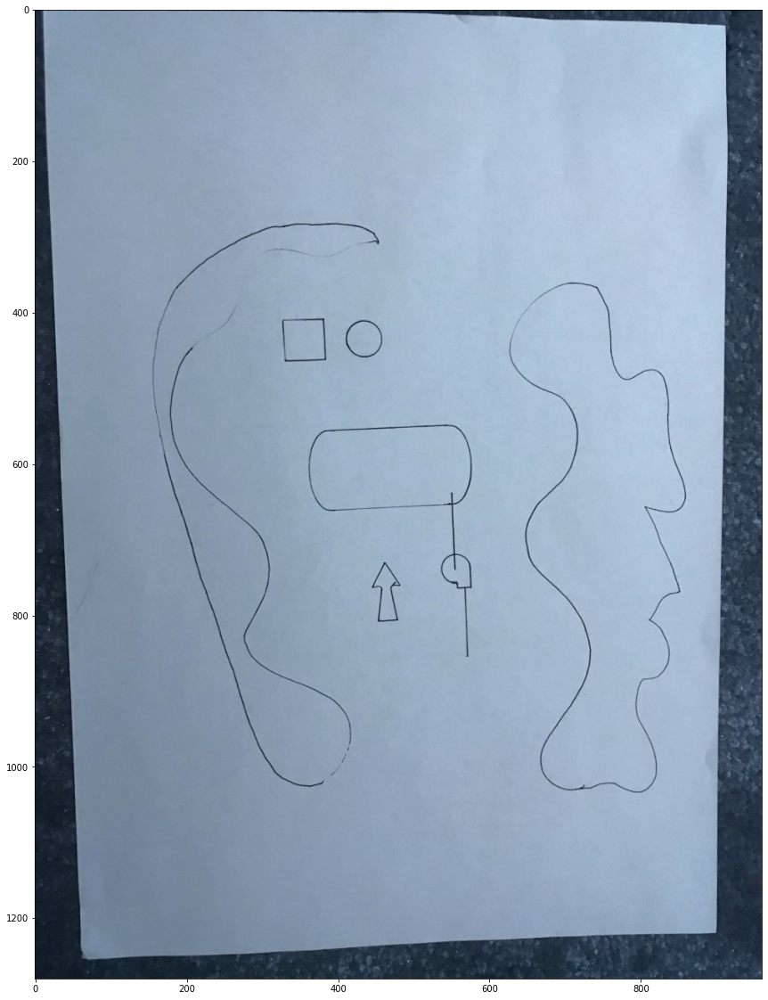

In [34]:
rua = np.copy(raw_images[0])

plt.figure(figsize = (24,20))
plt.imshow(rua)
plt.show()


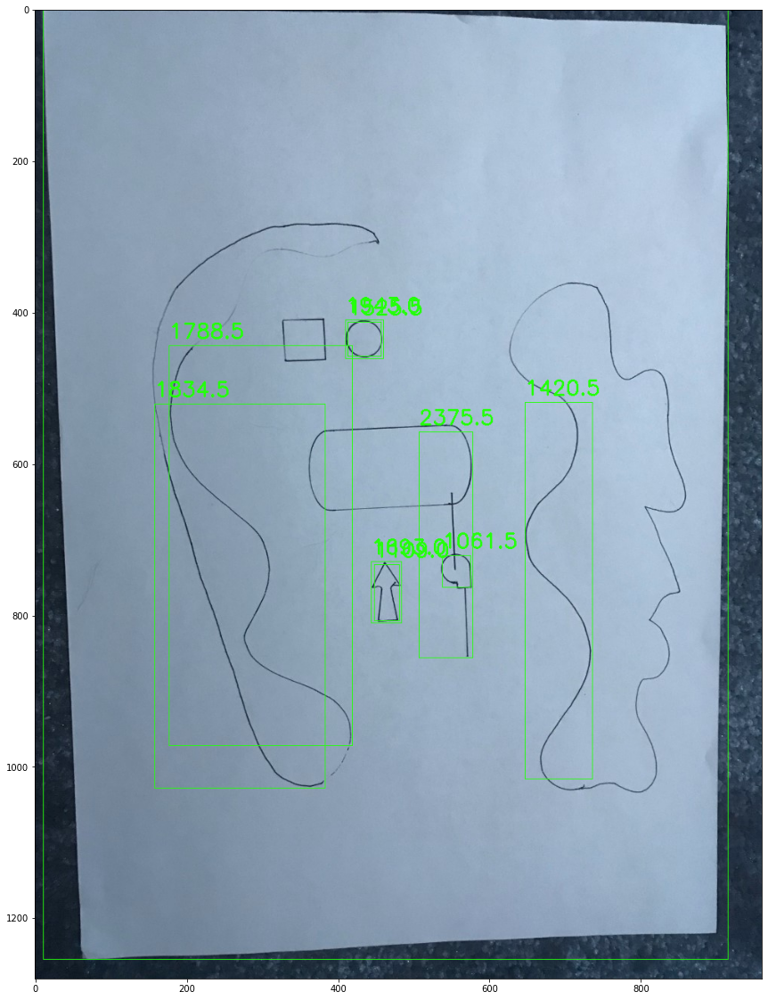

In [35]:

imgray = cv2.cvtColor(rua,cv2.COLOR_BGR2GRAY)
ret,thresh = cv2.threshold(imgray,130,255,0)
contours, hierarchy = cv2.findContours(thresh,cv2.RETR_TREE,cv2.CHAIN_APPROX_SIMPLE)
areas = []
img = np.copy(rua)

for c in contours:
    if cv2.contourArea(c) > 1000:
        x,y,w,h = cv2.boundingRect(c)
        cv2.putText(img, str(cv2.contourArea(c)), (x,y - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.9, (36,255,12), 2)
        cv2.rectangle(img, (x, y), (x + w, y + h), (36,255,12), 1)
        areas.append(cv2.contourArea(c))

plt.figure(figsize = (24,20))
plt.imshow(img)
plt.show()


(4, 1, 2)
[12, 63, 898, 911] [0, 1243, 1219, 22]


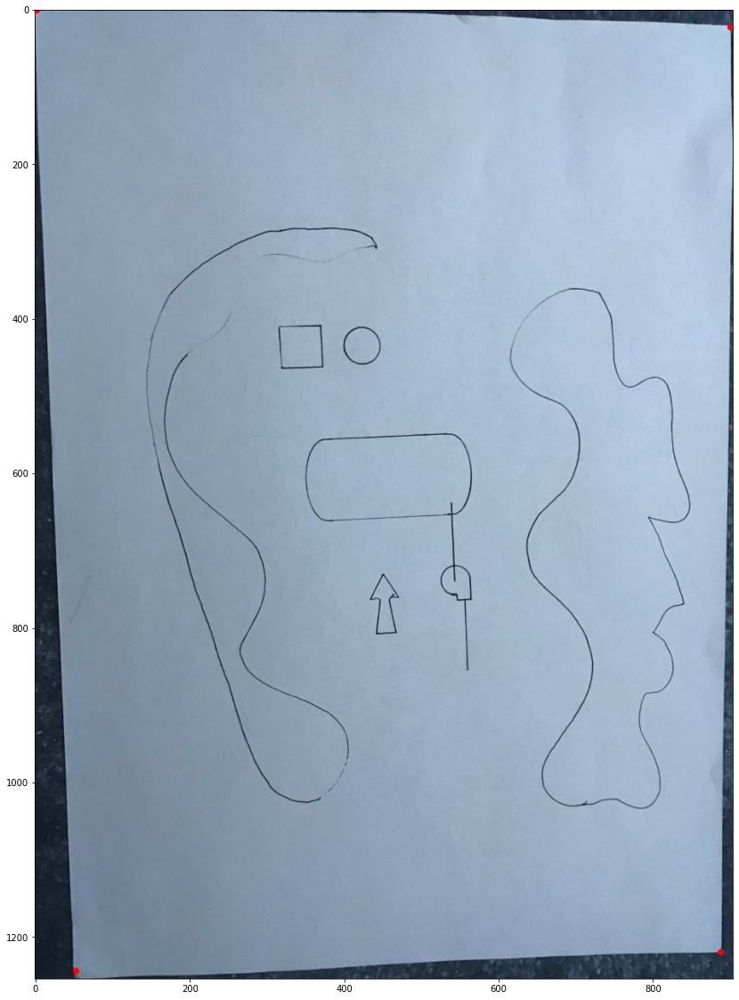

In [36]:

max_cont = [c for c in contours if cv2.contourArea(c) == max(areas)][0]

epsilon = 0.1*cv2.arcLength(max_cont,True)
approx = cv2.approxPolyDP(max_cont,epsilon,True)
print(approx.shape)

x_values = [approx[n][0][0] for n in range(len(approx))]
y_values = [approx[n][0][1] for n in range(len(approx))]

print(x_values, y_values)

x,y,w,h = cv2.boundingRect(max_cont)

part = np.copy(rua)[y:y+h, x:x+w]

part_x_values = np.array(x_values)-x
part_y_values = np.array(y_values)-y

plt.figure(figsize = (24,20))
plt.imshow(part)
plt.scatter(part_x_values, part_y_values, color='red')
plt.show()


[[1.000e+00 0.000e+00]
 [5.200e+01 1.243e+03]
 [8.870e+02 1.219e+03]
 [9.000e+02 2.200e+01]]


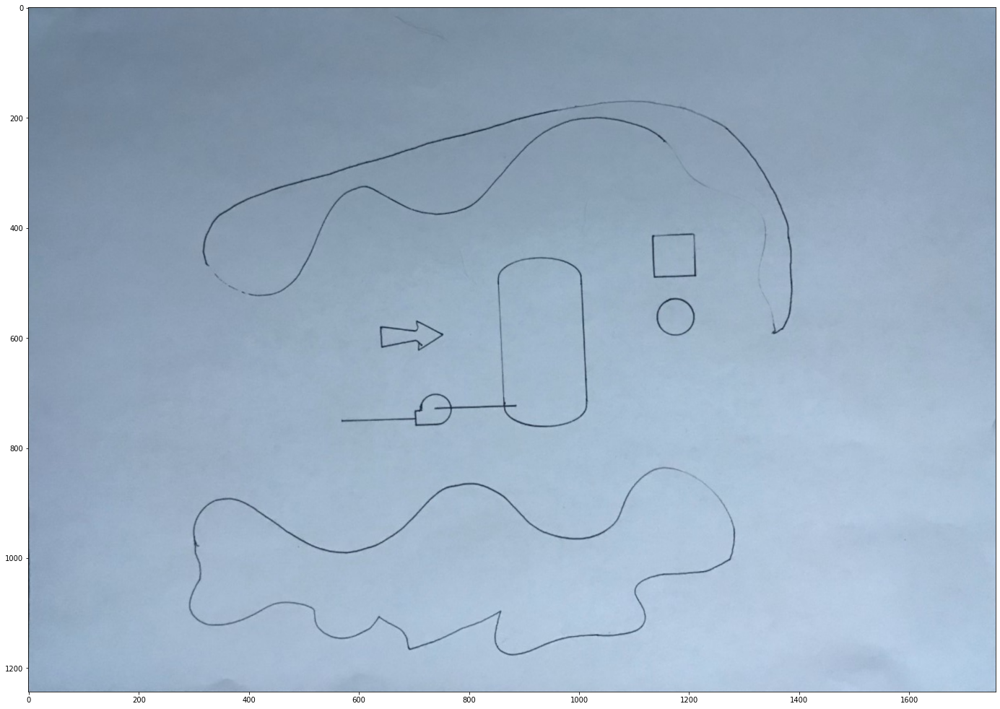

In [37]:

warped_poiints = np.float32(np.concatenate([part_x_values.reshape(-1,1), part_y_values.reshape(-1,1)], axis=1))
print(warped_poiints)

fixed_points = np.float32(
    [[max(part_y_values)*420/297, 0],
    [0, 0],
    [0, max(part_y_values)],
    [max(part_y_values)*420/297, max(part_y_values)]])

M = cv2.getPerspectiveTransform(warped_poiints,fixed_points)
dst = cv2.warpPerspective(part, M, np.int32([max(part_y_values)*420/297, max(part_y_values)]))

plt.figure(figsize = (24,20))
plt.imshow(dst)
plt.show()

In [38]:
processed_images = [dst]

# Two

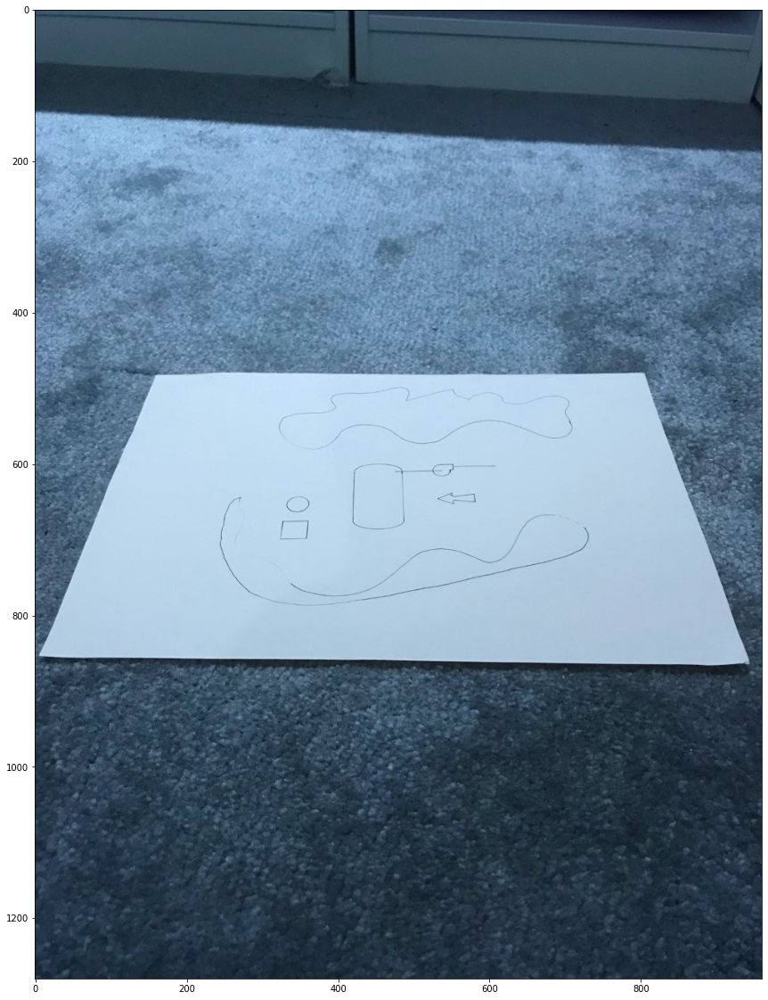

In [39]:
rua = np.copy(raw_images[1])

plt.figure(figsize = (24,20))
plt.imshow(rua)
plt.show()


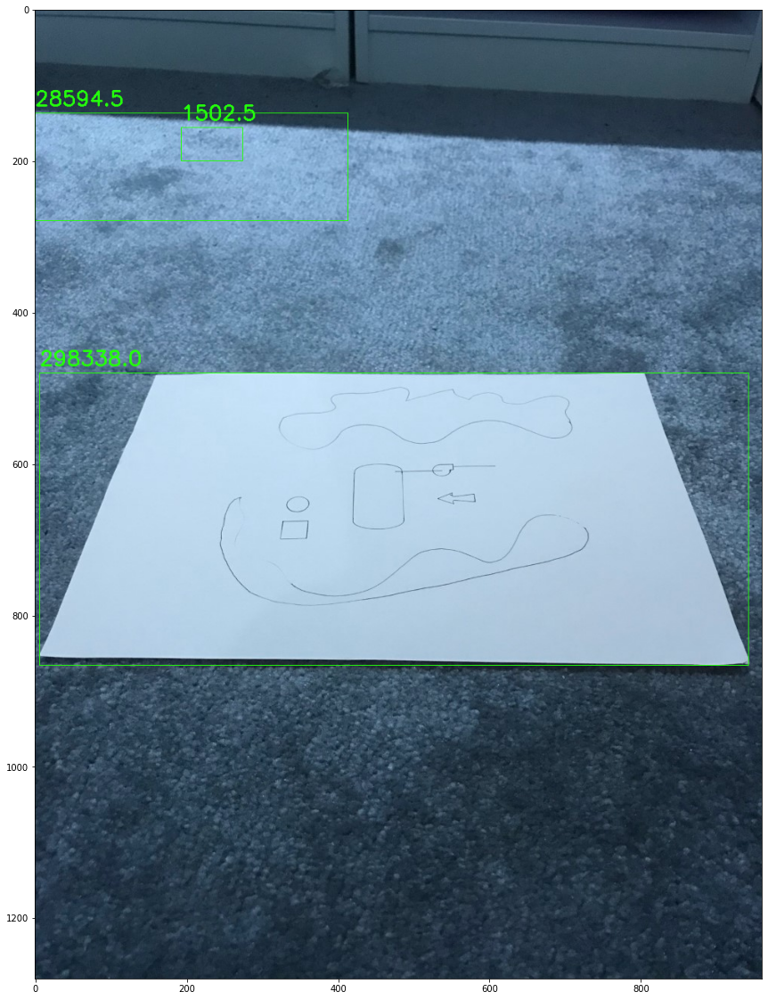

In [40]:

imgray = cv2.cvtColor(rua,cv2.COLOR_BGR2GRAY)
ret,thresh = cv2.threshold(imgray,180,255,0)
contours, hierarchy = cv2.findContours(thresh,cv2.RETR_TREE,cv2.CHAIN_APPROX_SIMPLE)
areas = []
img = np.copy(rua)

for c in contours:
    if cv2.contourArea(c) > 1000:
        x,y,w,h = cv2.boundingRect(c)
        cv2.putText(img, str(cv2.contourArea(c)), (x,y - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.9, (36,255,12), 2)
        cv2.rectangle(img, (x, y), (x + w, y + h), (36,255,12), 1)
        areas.append(cv2.contourArea(c))

plt.figure(figsize = (24,20))
plt.imshow(img)
plt.show()


(4, 1, 2)
[  0 935 793 154] [372 380   0   3]


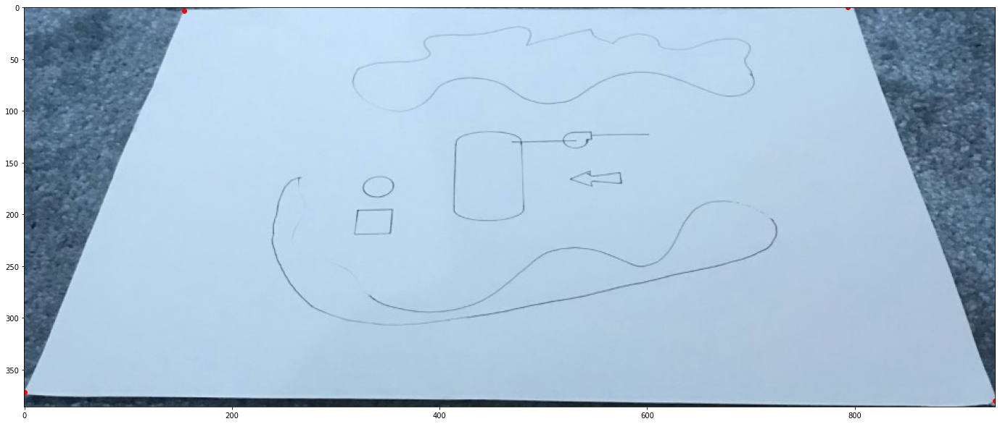

In [41]:

max_cont = [c for c in contours if cv2.contourArea(c) == max(areas)][0]

epsilon = 0.1*cv2.arcLength(max_cont,True)
approx = cv2.approxPolyDP(max_cont,epsilon,True)
print(approx.shape)

x_values = [approx[n][0][0] for n in range(len(approx))]
y_values = [approx[n][0][1] for n in range(len(approx))]

x,y,w,h = cv2.boundingRect(max_cont)

part = np.copy(rua)[y:y+h, x:x+w]

part_x_values = np.array(x_values)-x
part_y_values = np.array(y_values)-y
print(part_x_values, part_y_values)

plt.figure(figsize = (24,20))
plt.imshow(part)
plt.scatter(part_x_values, part_y_values, color='red')
plt.show()


[[  0. 372.]
 [935. 380.]
 [793.   0.]
 [154.   3.]]


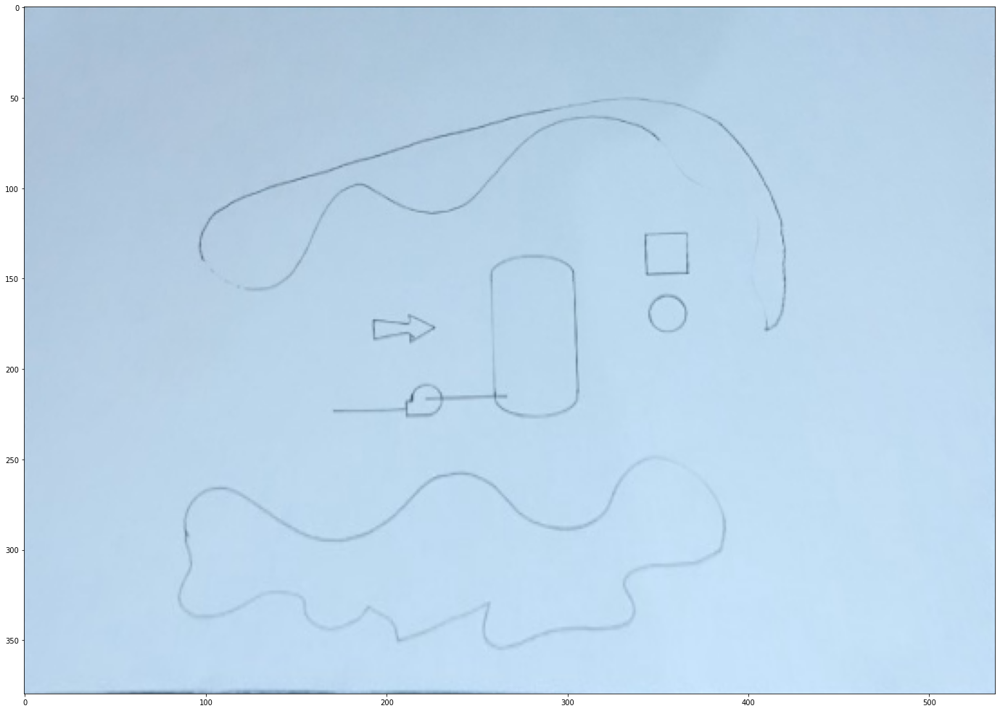

In [42]:

warped_poiints = np.float32(np.concatenate([part_x_values.reshape(-1,1), part_y_values.reshape(-1,1)], axis=1))
print(warped_poiints)

fixed_points = np.float32(
    [[max(part_y_values)*420/297, 0],
    [0, 0],
    [0, max(part_y_values)],
    [max(part_y_values)*420/297, max(part_y_values)]])

M = cv2.getPerspectiveTransform(warped_poiints,fixed_points)
dst = cv2.warpPerspective(part, M, np.int32([max(part_y_values)*420/297, max(part_y_values)]))

plt.figure(figsize = (24,20))
plt.imshow(dst)
plt.show()

In [43]:
processed_images.append(dst)

# Three

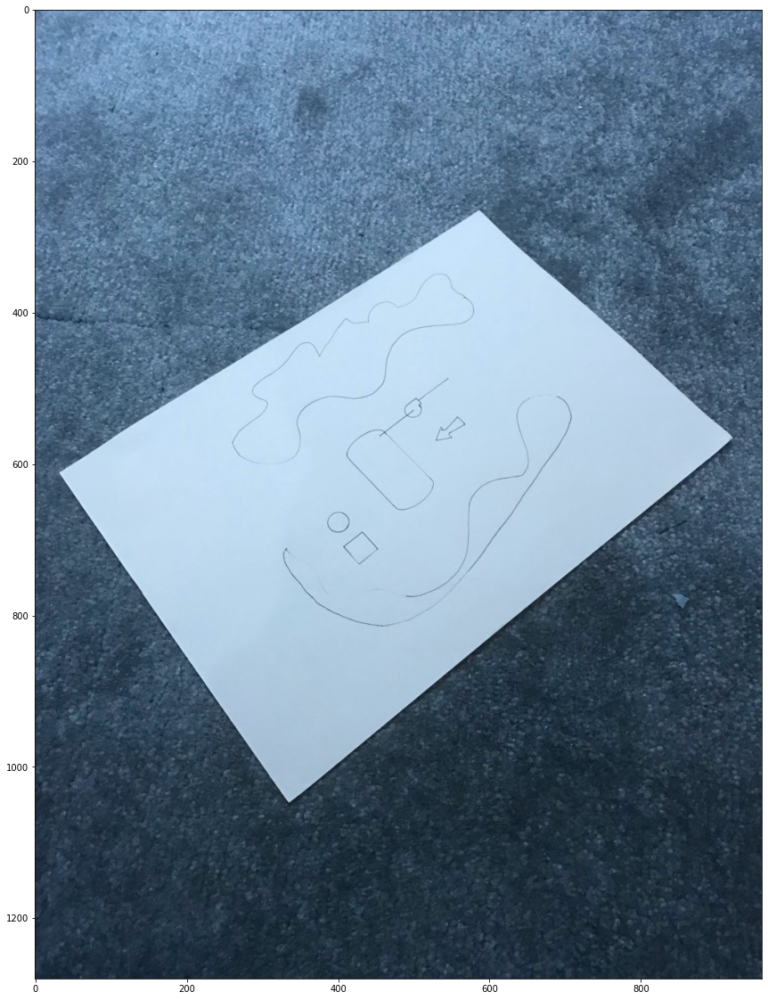

In [45]:
rua = np.copy(raw_images[2])

plt.figure(figsize = (24,20))
plt.imshow(rua)
plt.show()

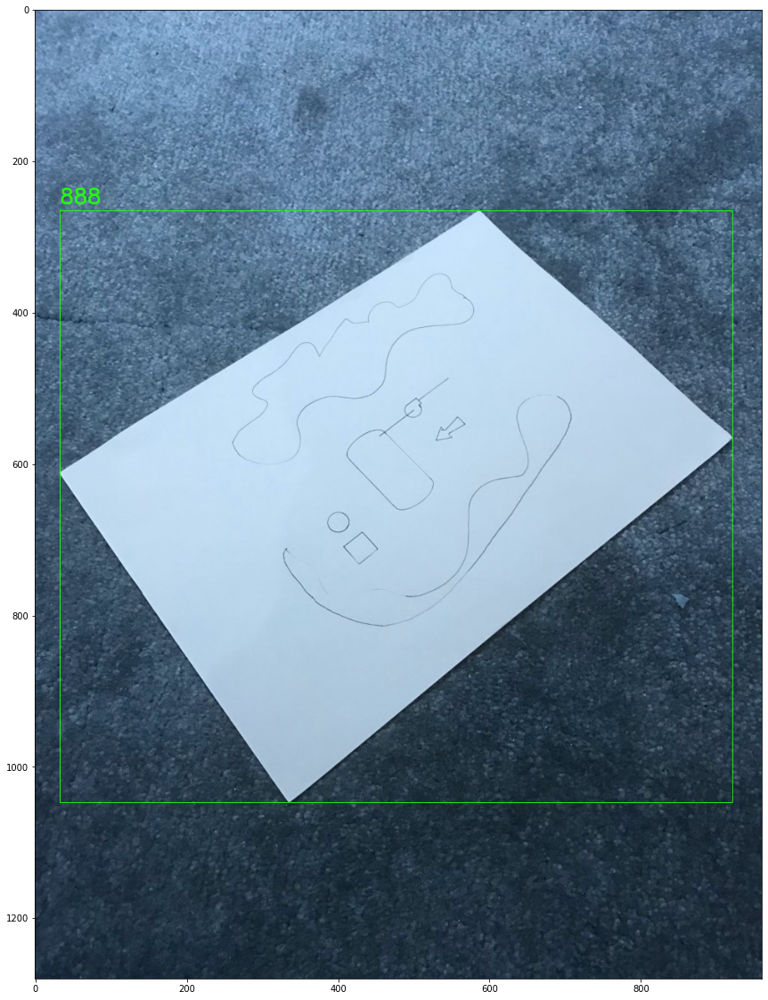

In [46]:
imgray = cv2.cvtColor(rua,cv2.COLOR_BGR2GRAY)
ret,thresh = cv2.threshold(imgray,180,255,0)
contours, hierarchy = cv2.findContours(thresh,cv2.RETR_TREE,cv2.CHAIN_APPROX_SIMPLE)
areas = []
img = np.copy(rua)

for c in contours:
    if cv2.contourArea(c) > 1000:
        x,y,w,h = cv2.boundingRect(c)
        cv2.putText(img, str(w), (x,y - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.9, (36,255,12), 2)
        cv2.rectangle(img, (x, y), (x + w, y + h), (36,255,12), 1)
        areas.append(cv2.contourArea(c))

plt.figure(figsize = (24,20))
plt.imshow(img)
plt.show()

In [47]:
max_cont = [c for c in contours if cv2.contourArea(c) == max(areas)][0]

In [48]:
epsilon = 0.1*cv2.arcLength(max_cont,True)
approx = cv2.approxPolyDP(max_cont,epsilon,True)
print(approx.shape)

x_values = [approx[n][0][0] for n in range(len(approx))]
y_values = [approx[n][0][1] for n in range(len(approx))]

print(x_values, y_values)

(4, 1, 2)
[587, 33, 336, 920] [266, 611, 1046, 566]


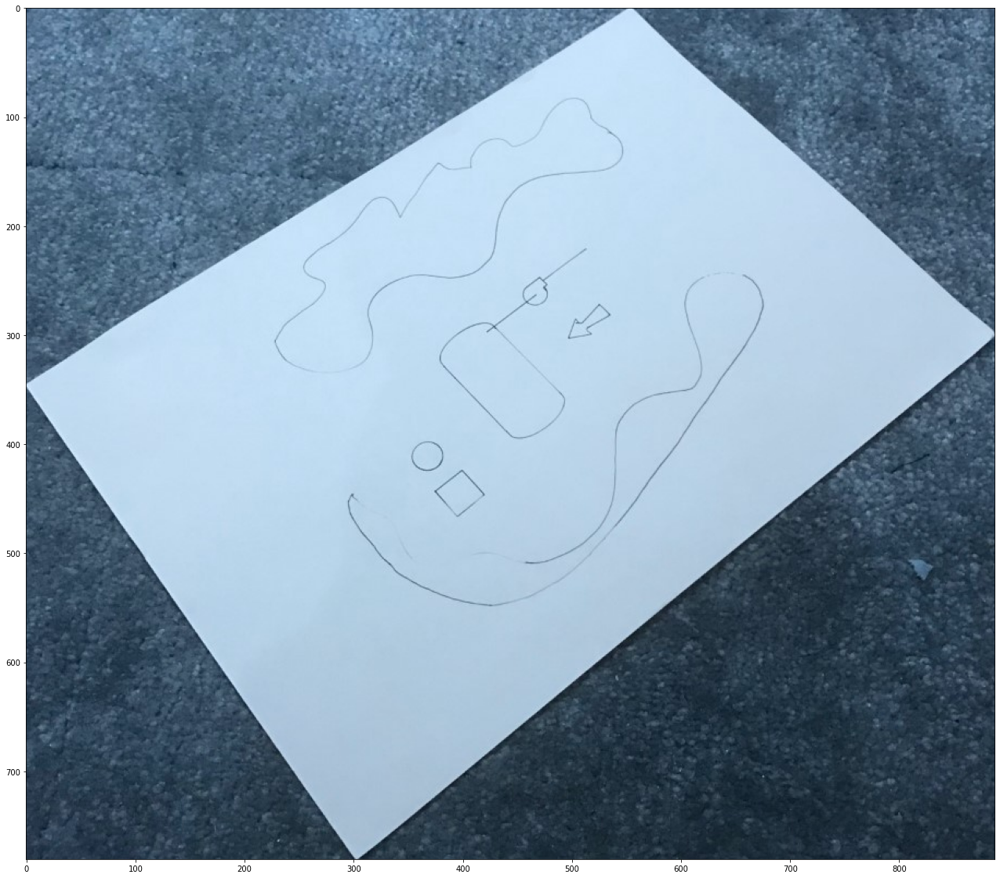

In [49]:
x,y,w,h = cv2.boundingRect(max_cont)

part = np.copy(rua)[y:y+h, x:x+w]

part_x_values = np.array(x_values)-x
part_y_values = np.array(y_values)-y

plt.figure(figsize = (24,20))
plt.imshow(part)
plt.show()

In [50]:
warped_poiints = np.float32(np.concatenate([part_x_values.reshape(-1,1), part_y_values.reshape(-1,1)], axis=1))
fixed_points = np.float32(
    [[0, max(part_y_values)],
     [max(part_y_values)*420/297, max(part_y_values)],
     [max(part_y_values)*420/297, 0],
     [0, 0]])

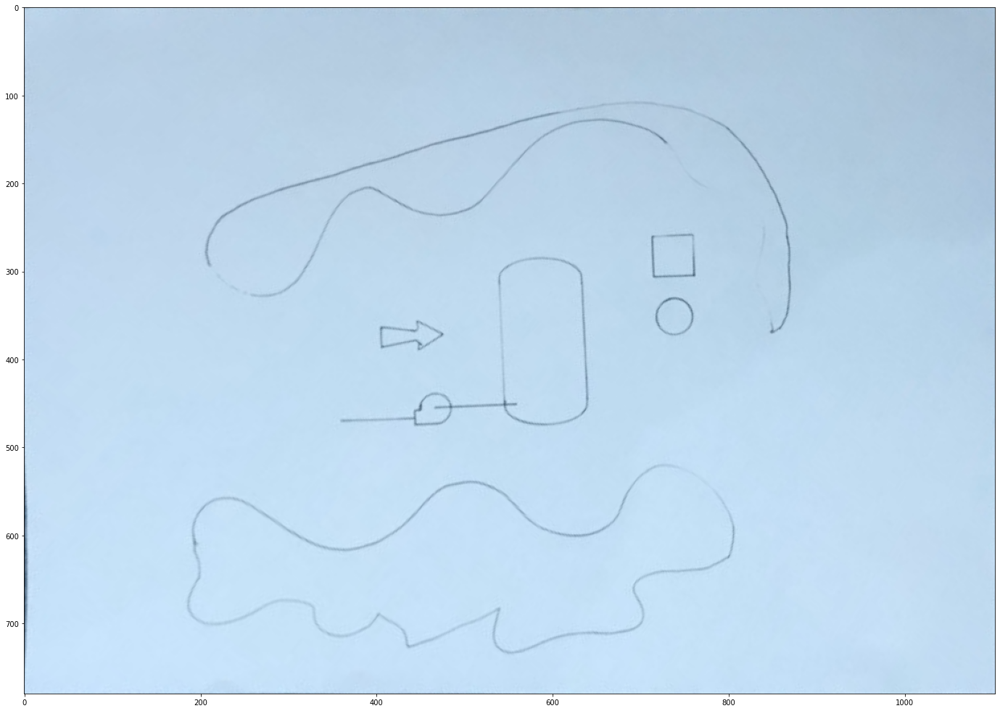

In [51]:
M = cv2.getPerspectiveTransform(warped_poiints,fixed_points)
dst = cv2.warpPerspective(part, M, np.int32([max(part_y_values)*420/297, max(part_y_values)]))

plt.figure(figsize = (24,20))
plt.imshow(dst)
plt.show()

In [52]:
processed_images.append(dst)

# Four

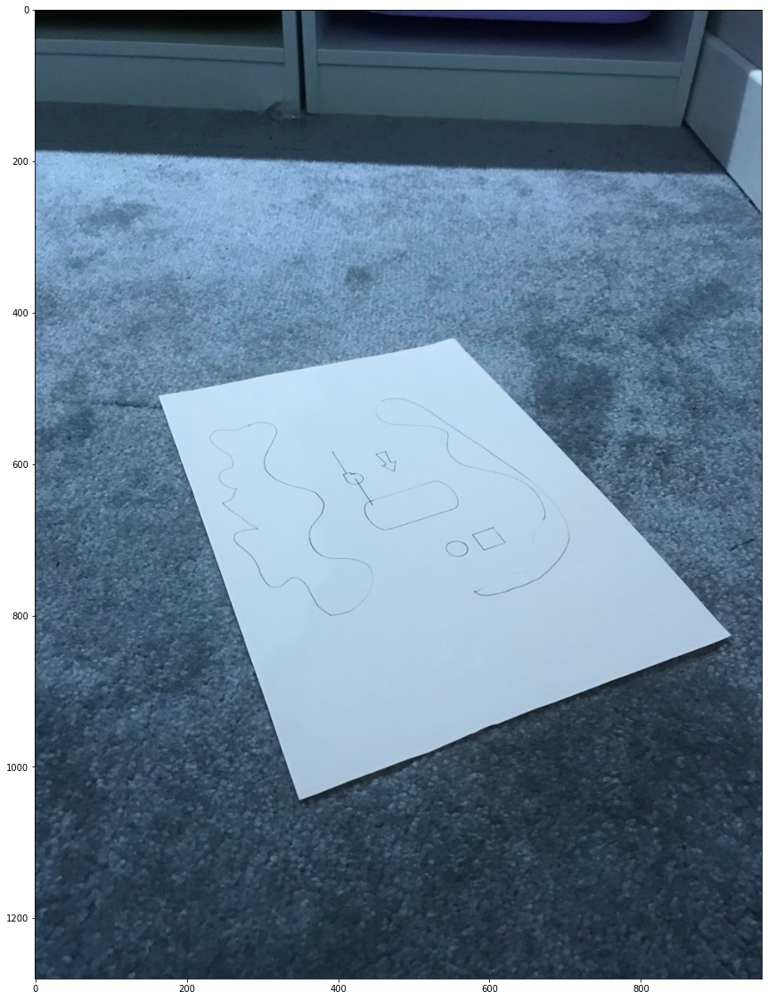

In [53]:
rua = np.copy(raw_images[3])

plt.figure(figsize = (24,20))
plt.imshow(rua)
plt.show()

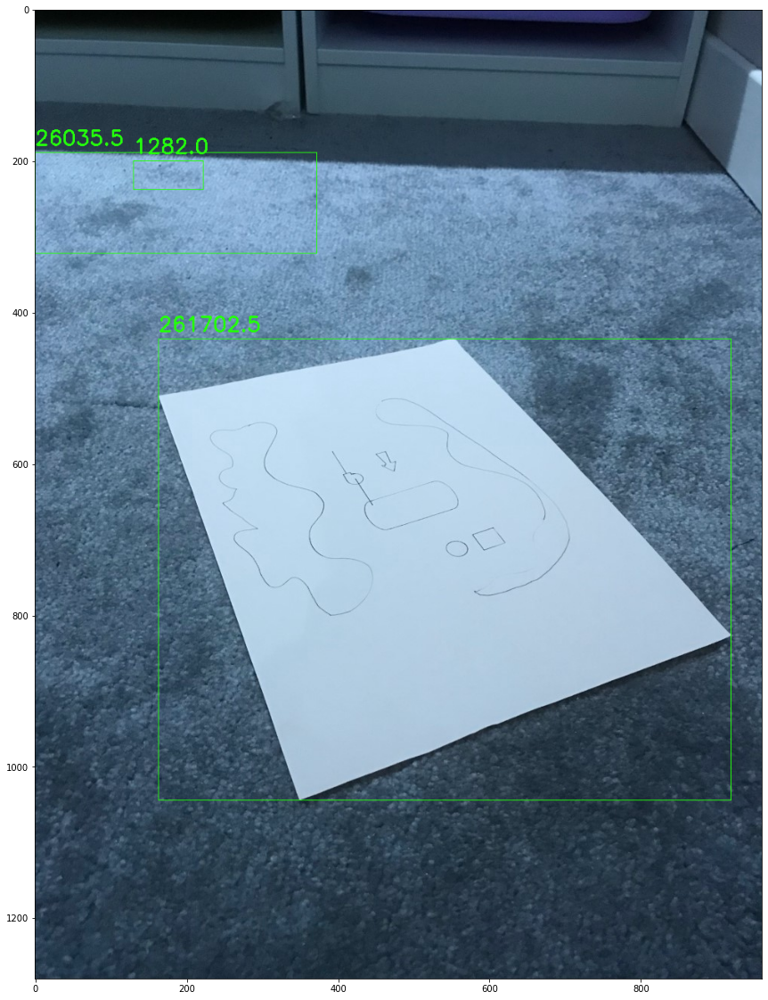

In [54]:
imgray = cv2.cvtColor(rua,cv2.COLOR_BGR2GRAY)
ret,thresh = cv2.threshold(imgray,180,255,0)
contours, hierarchy = cv2.findContours(thresh,cv2.RETR_TREE,cv2.CHAIN_APPROX_SIMPLE)
areas = []
img = np.copy(rua)

for c in contours:
    if cv2.contourArea(c) > 1000:
        x,y,w,h = cv2.boundingRect(c)
        cv2.putText(img, str(cv2.contourArea(c)), (x,y - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.9, (36,255,12), 2)
        cv2.rectangle(img, (x, y), (x + w, y + h), (36,255,12), 1)
        areas.append(cv2.contourArea(c))

plt.figure(figsize = (24,20))
plt.imshow(img)
plt.show()

(4, 1, 2)
[391   0 187 755] [  0  76 608 391]


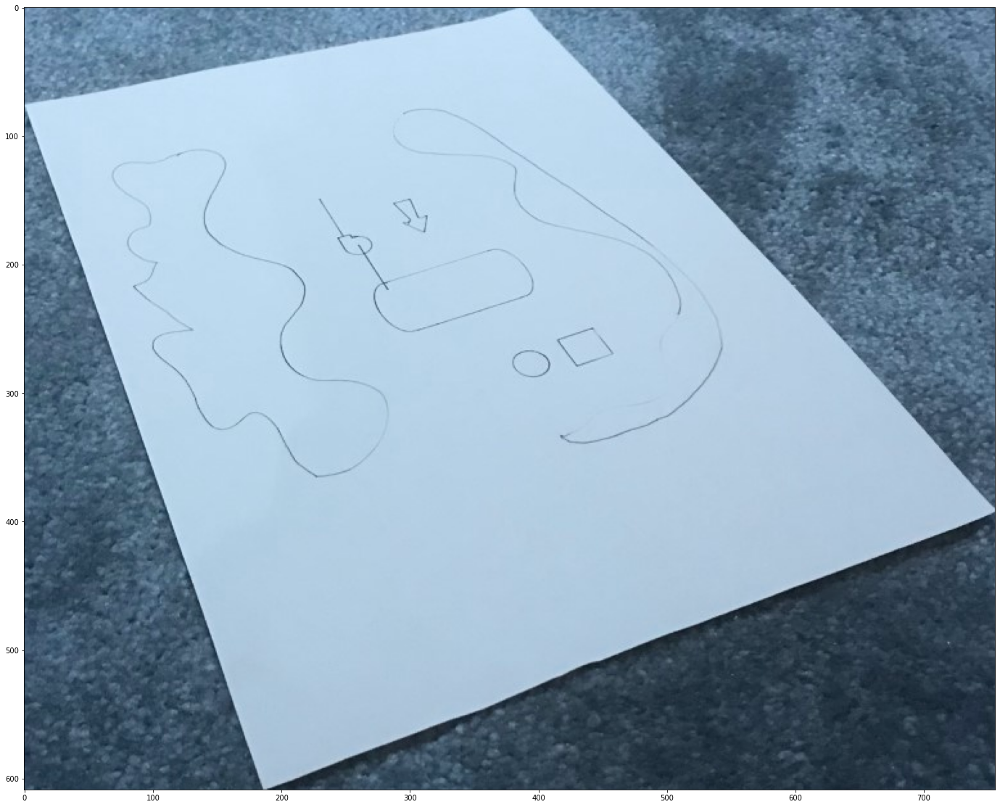

In [55]:
max_cont = [c for c in contours if cv2.contourArea(c) == max(areas)][0]

epsilon = 0.1*cv2.arcLength(max_cont,True)
approx = cv2.approxPolyDP(max_cont,epsilon,True)
print(approx.shape)

x_values = [approx[n][0][0] for n in range(len(approx))]
y_values = [approx[n][0][1] for n in range(len(approx))]

x,y,w,h = cv2.boundingRect(max_cont)

part = np.copy(rua)[y:y+h, x:x+w]

part_x_values = np.array(x_values)-x
part_y_values = np.array(y_values)-y
print(part_x_values, part_y_values)

plt.figure(figsize = (24,20))
plt.imshow(part)
plt.show()

In [56]:
warped_poiints = np.float32(np.concatenate([part_x_values.reshape(-1,1), part_y_values.reshape(-1,1)], axis=1))
print(warped_poiints)


[[391.   0.]
 [  0.  76.]
 [187. 608.]
 [755. 391.]]


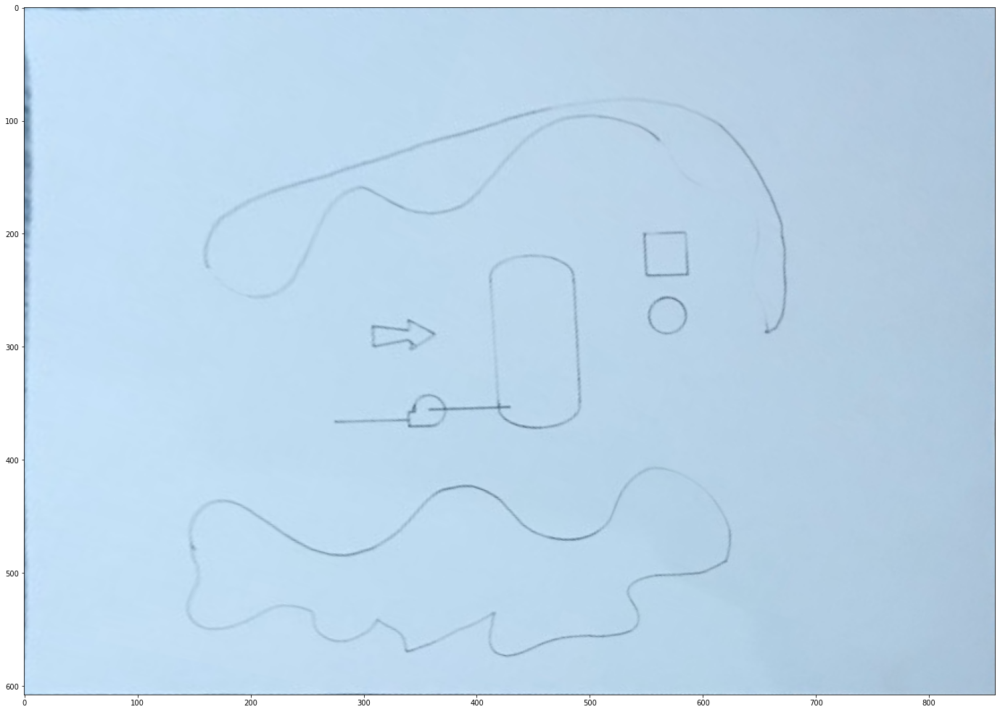

In [57]:
fixed_points = np.float32(
    [[0, 0],
    [0, max(part_y_values)],
    [max(part_y_values)*420/297, max(part_y_values)],
    [max(part_y_values)*420/297, 0]])

M = cv2.getPerspectiveTransform(warped_poiints,fixed_points)
dst = cv2.warpPerspective(part, M, np.int32([max(part_y_values)*420/297, max(part_y_values)]))

plt.figure(figsize = (24,20))
plt.imshow(dst)
plt.show()

In [58]:
processed_images.append(dst)

# Five

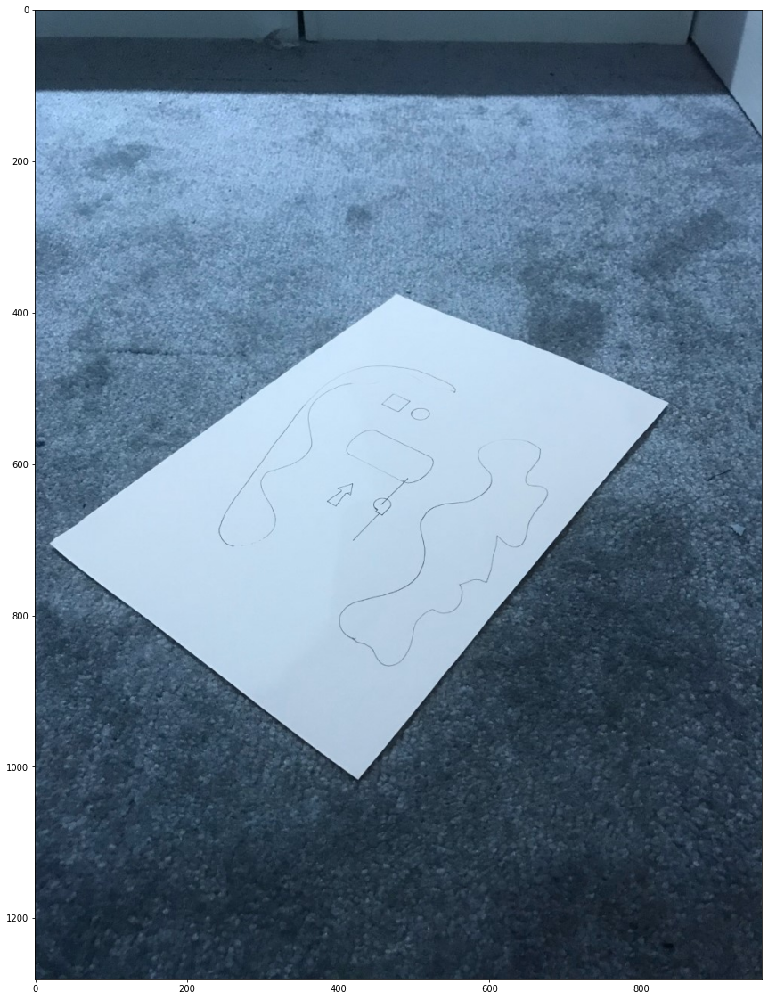

In [59]:
rua = np.copy(raw_images[4])

plt.figure(figsize = (24,20))
plt.imshow(rua)
plt.show()

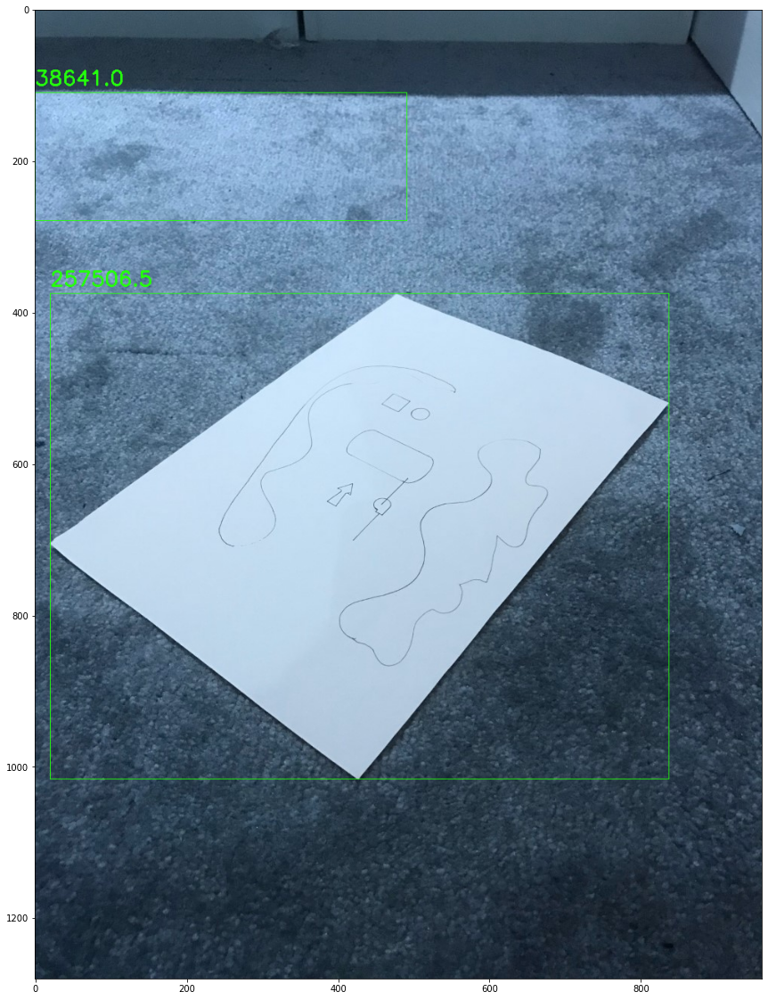

In [60]:
imgray = cv2.cvtColor(rua,cv2.COLOR_BGR2GRAY)
ret,thresh = cv2.threshold(imgray,180,255,0)
contours, hierarchy = cv2.findContours(thresh,cv2.RETR_TREE,cv2.CHAIN_APPROX_SIMPLE)
areas = []
img = np.copy(rua)

for c in contours:
    if cv2.contourArea(c) > 1000:
        x,y,w,h = cv2.boundingRect(c)
        cv2.putText(img, str(cv2.contourArea(c)), (x,y - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.9, (36,255,12), 2)
        cv2.rectangle(img, (x, y), (x + w, y + h), (36,255,12), 1)
        areas.append(cv2.contourArea(c))

plt.figure(figsize = (24,20))
plt.imshow(img)
plt.show()

(4, 1, 2)
[835, 475, 20, 427] [519, 375, 705, 1015]


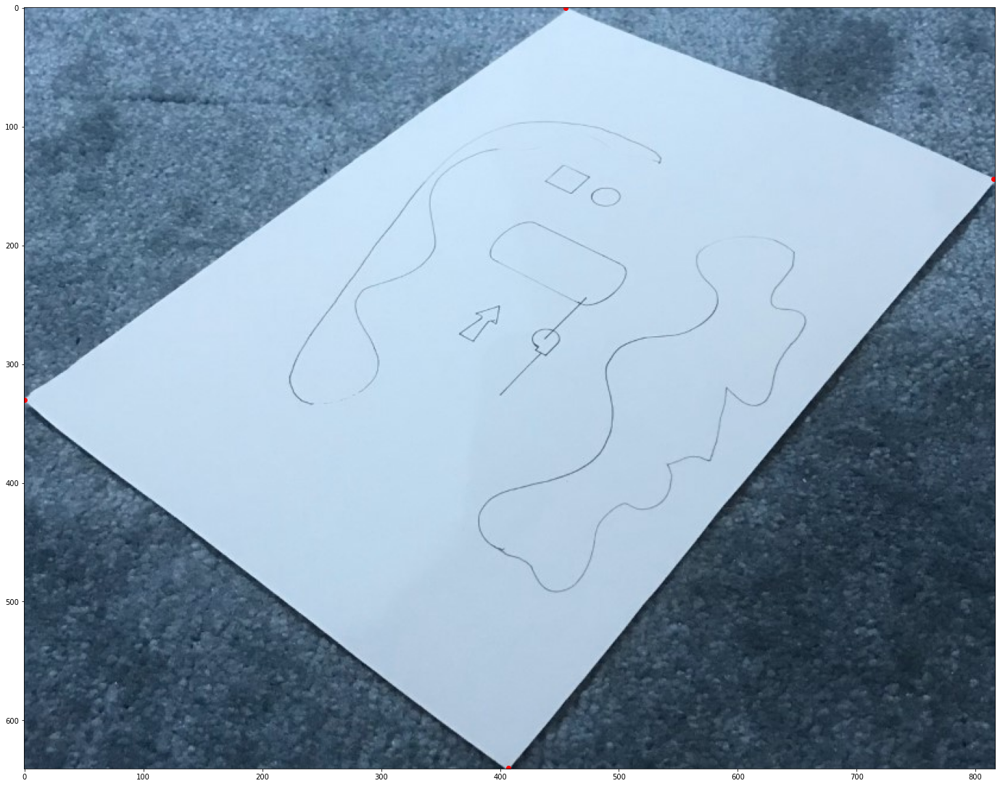

In [61]:
max_cont = [c for c in contours if cv2.contourArea(c) == max(areas)][0]

epsilon = 0.05*cv2.arcLength(max_cont,True)
approx = cv2.approxPolyDP(max_cont,epsilon,True)
print(approx.shape)

x_values = [approx[n][0][0] for n in range(len(approx))]
y_values = [approx[n][0][1] for n in range(len(approx))]

print(x_values, y_values)

x,y,w,h = cv2.boundingRect(max_cont)

part = np.copy(rua)[y:y+h, x:x+w]

part_x_values = np.array(x_values)-x
part_y_values = np.array(y_values)-y

plt.figure(figsize = (24,20))
plt.imshow(part)
plt.scatter(part_x_values, part_y_values, color='red')
plt.show()

[[815. 144.]
 [455.   0.]
 [  0. 330.]
 [407. 640.]]


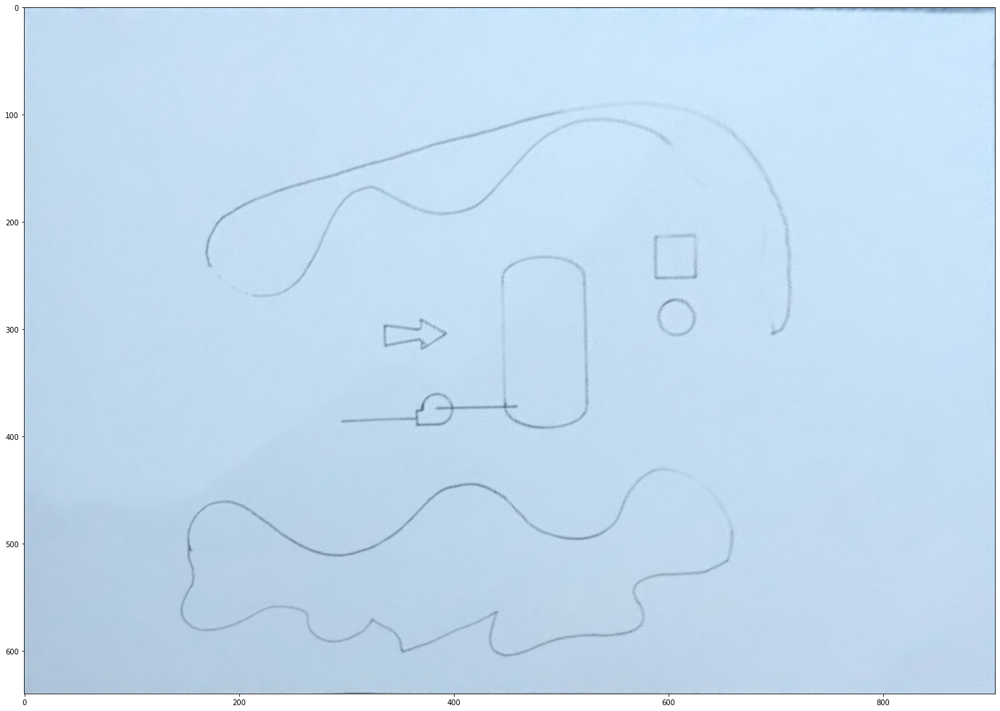

In [62]:
warped_poiints = np.float32(np.concatenate([part_x_values.reshape(-1,1), part_y_values.reshape(-1,1)], axis=1))
print(warped_poiints)

fixed_points = np.float32(
    [[max(part_y_values)*420/297, max(part_y_values)],
     [max(part_y_values)*420/297, 0],
     [0, 0],
     [0, max(part_y_values)]])

M = cv2.getPerspectiveTransform(warped_poiints,fixed_points)
dst = cv2.warpPerspective(part, M, np.int32([max(part_y_values)*420/297, max(part_y_values)]))

plt.figure(figsize = (24,20))
plt.imshow(dst)
plt.show()

In [63]:
processed_images.append(dst)

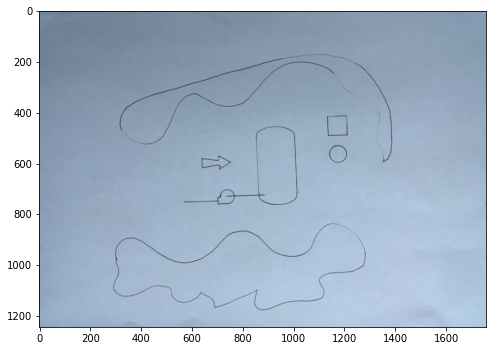

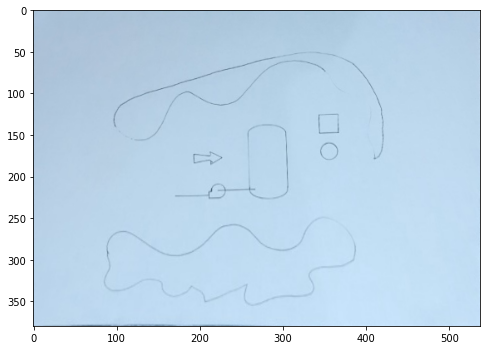

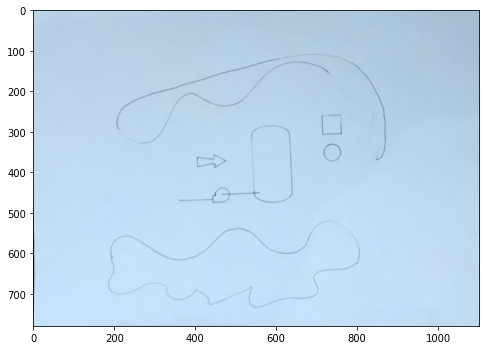

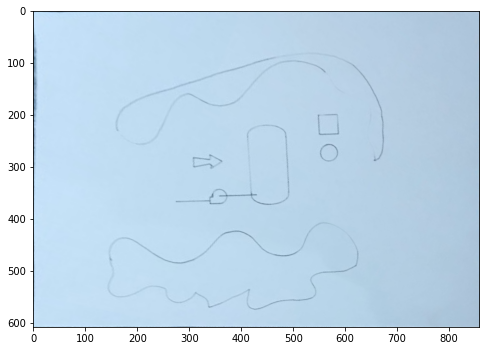

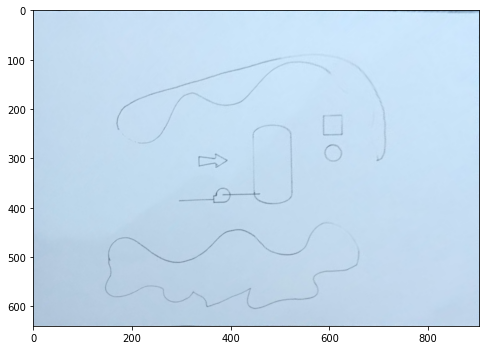

In [122]:
for n, img in enumerate(processed_images):
    plt.figure(figsize = (8,6))
    plt.imshow(img)
    plt.savefig('processed_'+str(n)+'.jpg')
    plt.show()

In [66]:
for img in processed_images:
    print(img.shape)

(1243, 1757, 3)
(380, 537, 3)
(780, 1103, 3)
(608, 859, 3)
(640, 905, 3)


In [87]:
resized = [cv2.resize(img, dsize=(537, 380), interpolation=cv2.INTER_CUBIC) for img in processed_images]

In [88]:
for img in resized:
    print(img.shape)

(380, 537, 3)
(380, 537, 3)
(380, 537, 3)
(380, 537, 3)
(380, 537, 3)


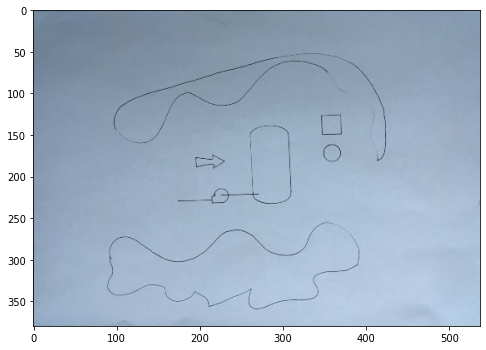

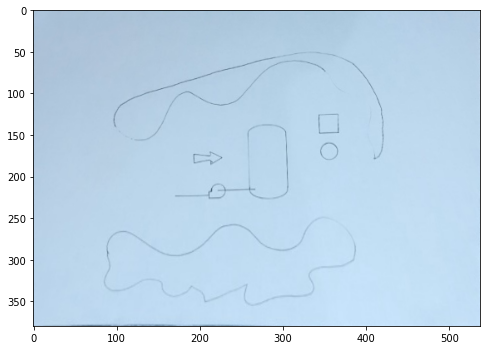

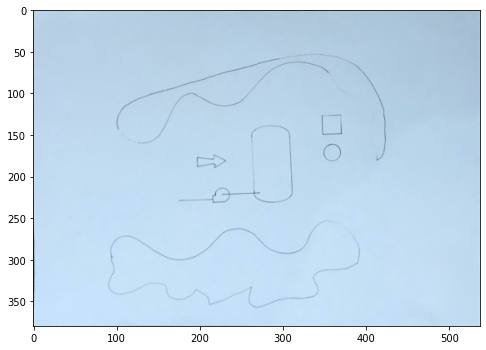

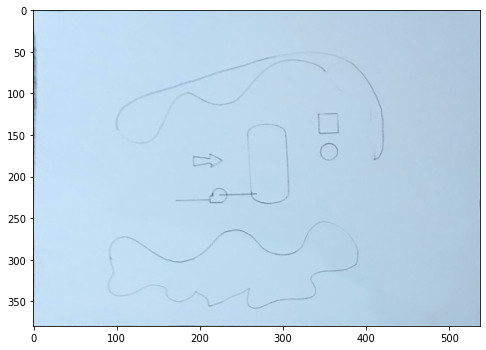

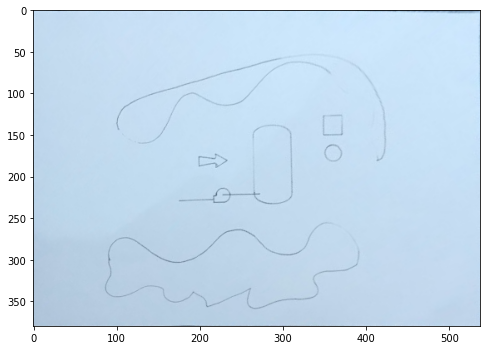

In [89]:
for img in resized:
    plt.figure(figsize = (8,6))
    plt.imshow(img)
    plt.show()

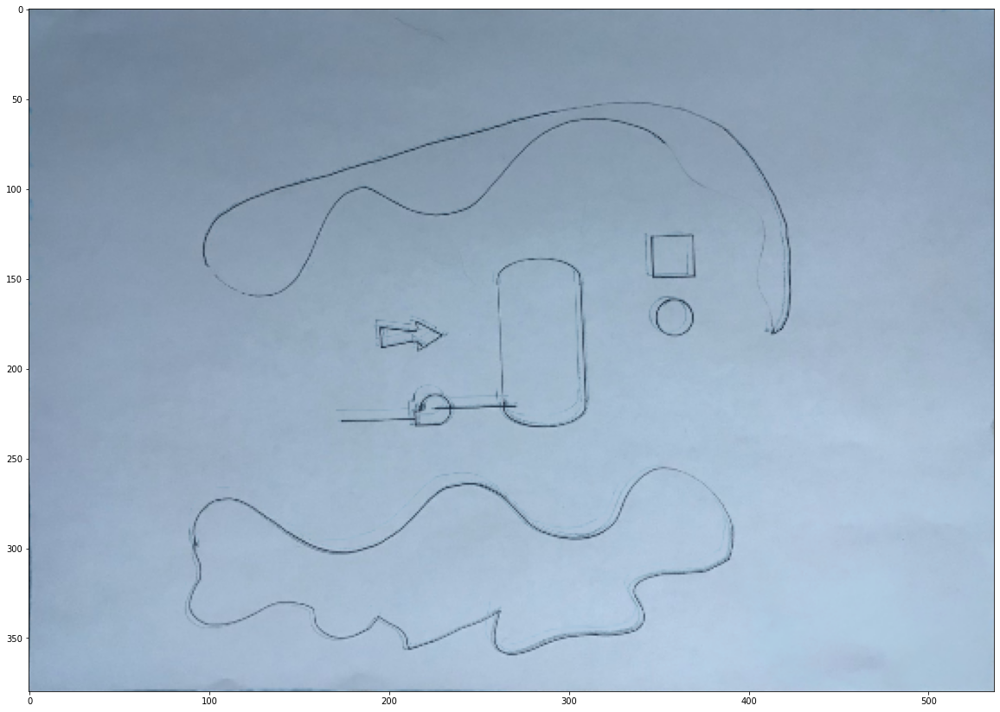

In [114]:
combined = np.minimum.reduce(resized)
plt.figure(figsize = (20,16))
plt.imshow(combined)
plt.show()

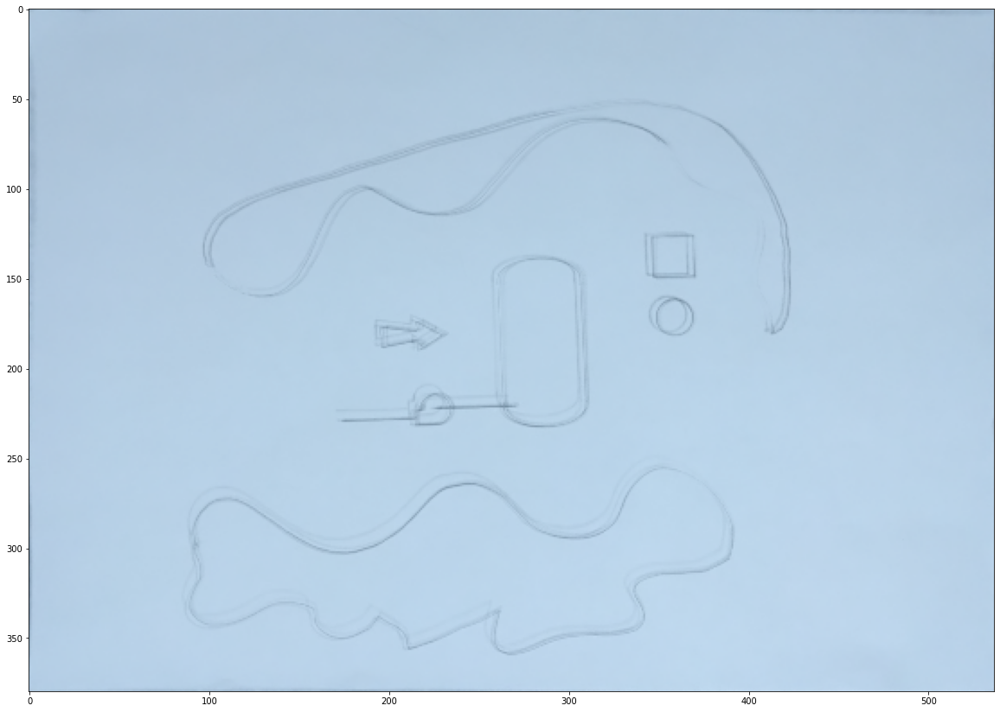

In [121]:
combined = np.int32(np.mean(np.array(resized), axis=0))
combined
plt.figure(figsize = (20,16))
plt.imshow(combined)
plt.savefig('combined.jpg')
plt.show()

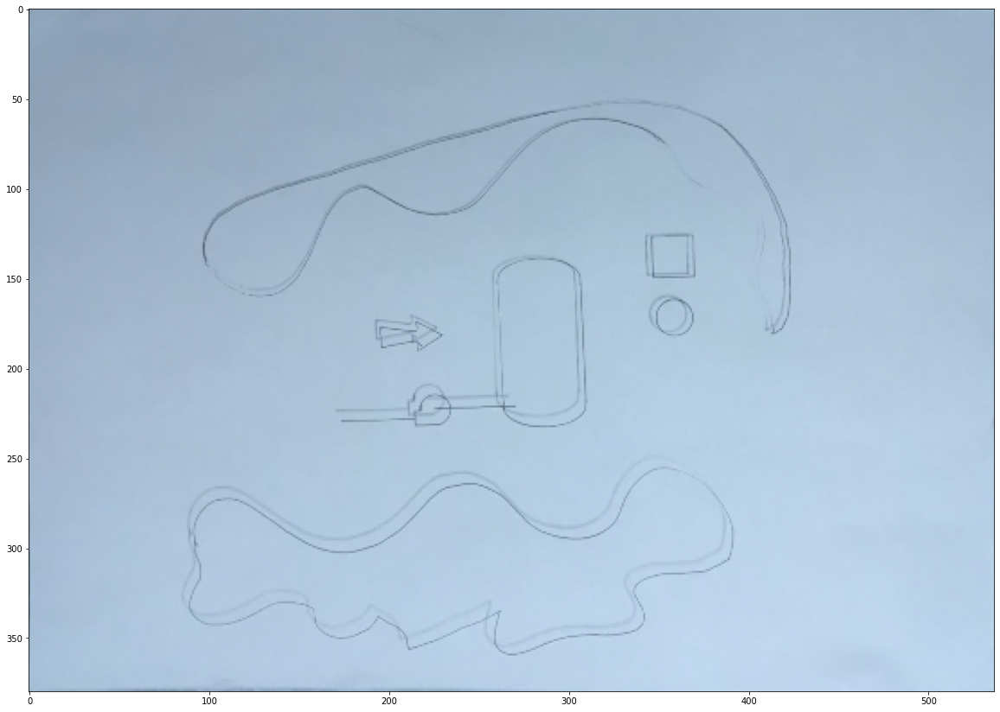

In [99]:
combined = cv2.addWeighted(resized[0], 0.5, resized[1], 0.5, 0)
plt.figure(figsize = (20,16))
plt.imshow(combined)
plt.show()

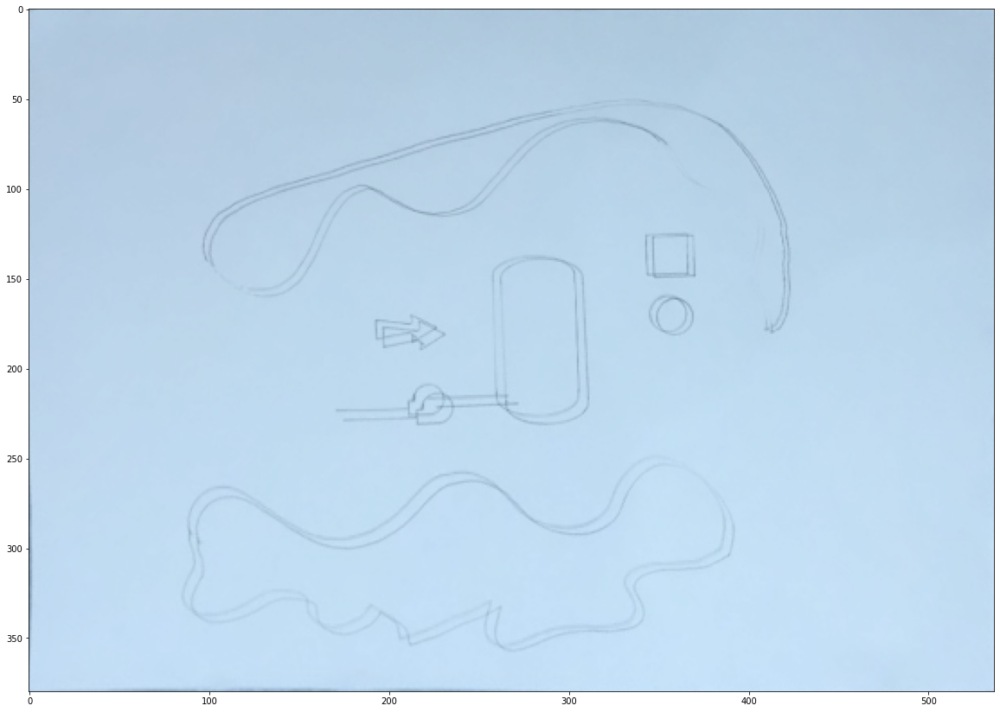

In [100]:
combined = cv2.addWeighted(resized[1], 0.5, resized[2], 0.5, 0)
plt.figure(figsize = (20,16))
plt.imshow(combined)
plt.show()

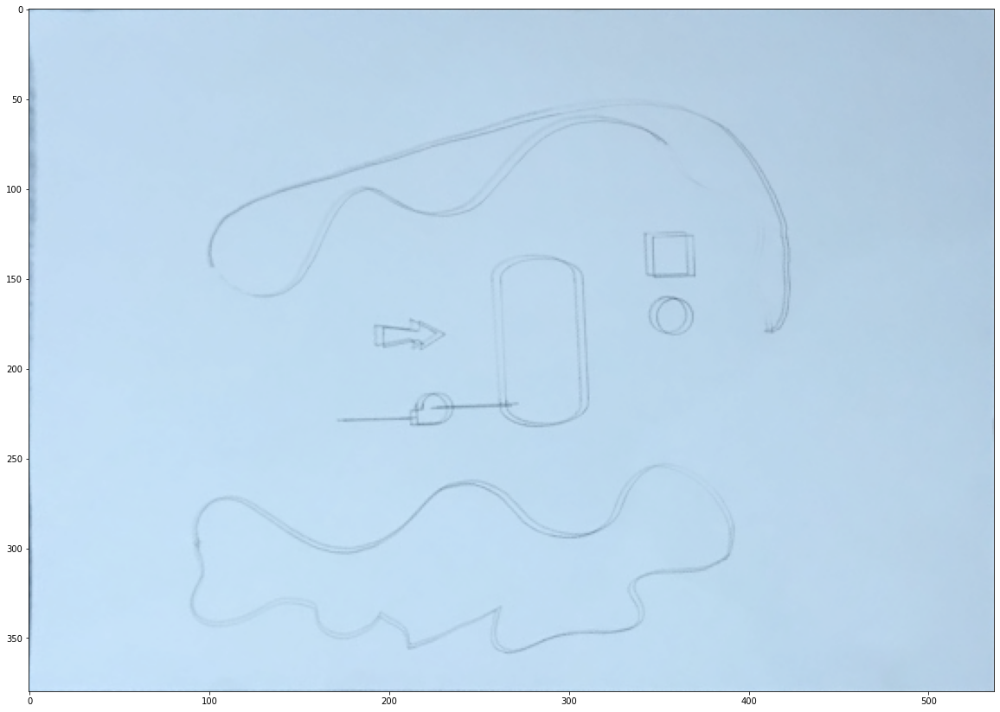

In [101]:
combined = cv2.addWeighted(resized[2], 0.5, resized[3], 0.5, 0)
plt.figure(figsize = (20,16))
plt.imshow(combined)
plt.show()

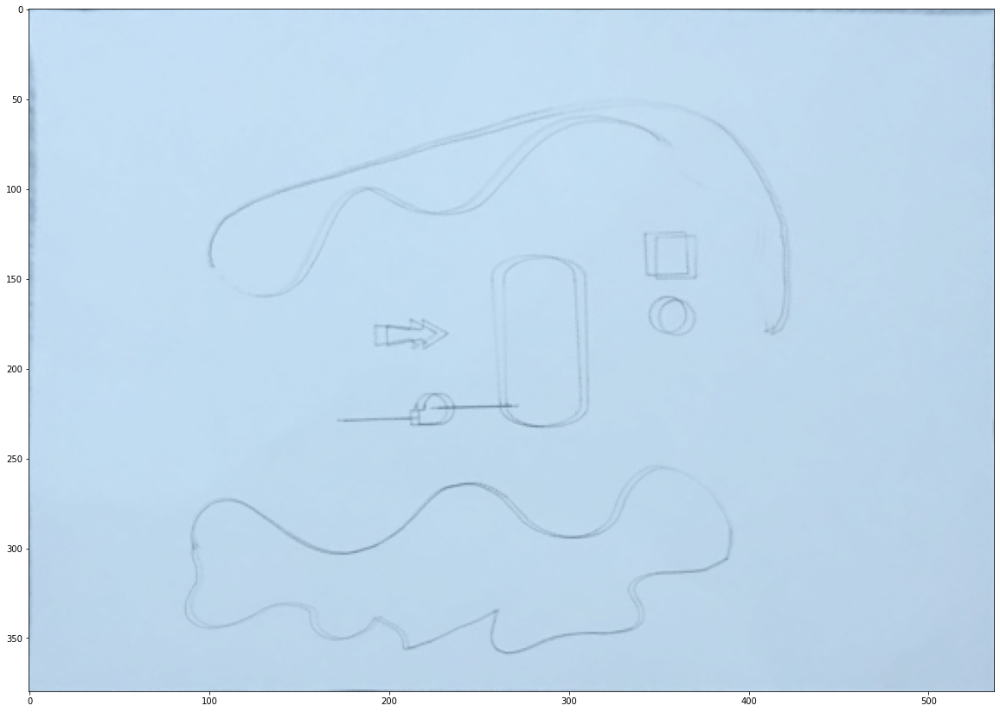

In [102]:
combined = cv2.addWeighted(resized[3], 0.5, resized[4], 0.5, 0)
plt.figure(figsize = (20,16))
plt.imshow(combined)
plt.show()

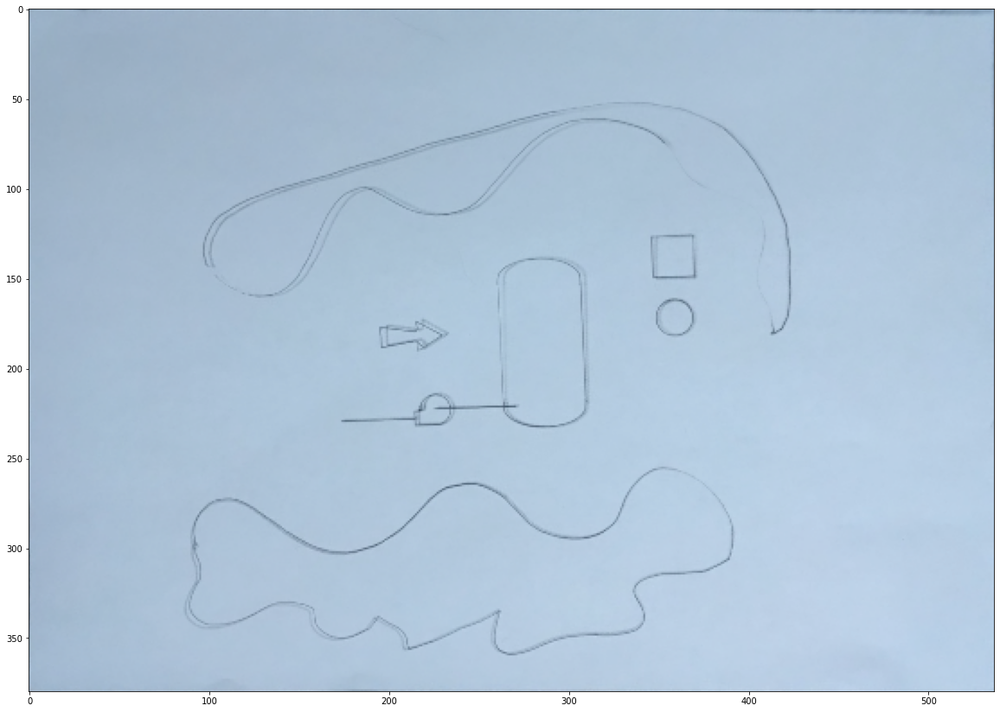

In [103]:
combined = cv2.addWeighted(resized[4], 0.5, resized[0], 0.5, 0)
plt.figure(figsize = (20,16))
plt.imshow(combined)
plt.show()

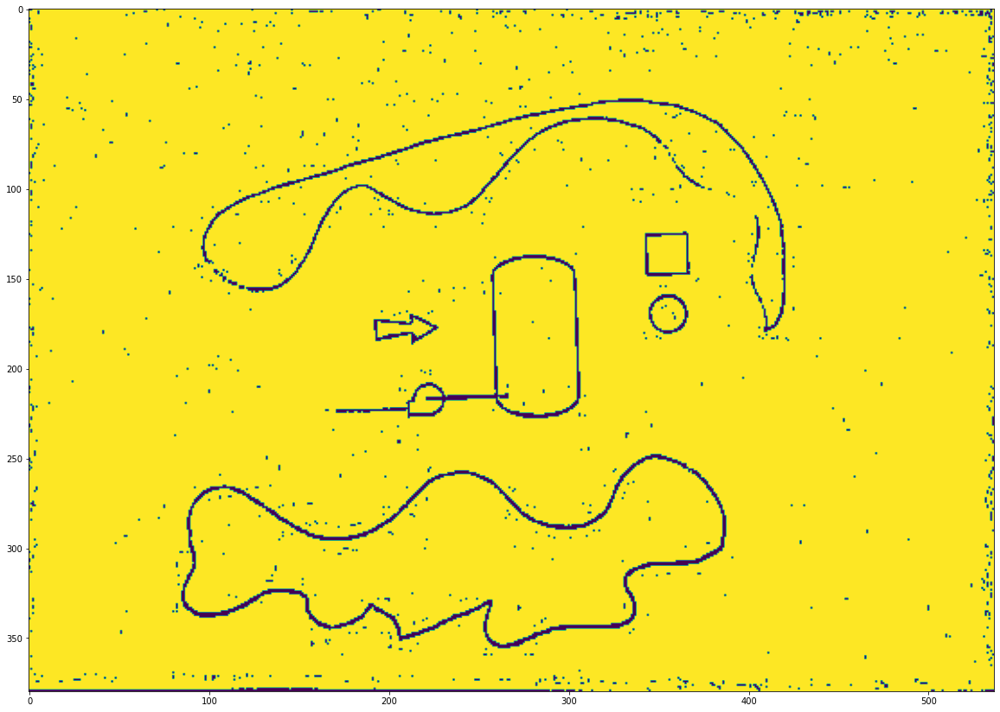

In [112]:
# th3 = cv2.adaptiveThreshold(processed_images[1],255,cv2.ADAPTIVE_THRESH_GAUSSIAN_C,\cv2.THRESH_BINARY,11,2)
img = cv2.cvtColor(processed_images[1], cv2.COLOR_BGR2GRAY)
th3 = cv2.adaptiveThreshold(img,255,cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY,11,2)

plt.figure(figsize = (20,16))
plt.imshow(th3)
plt.show()

In [142]:
numLabels, labels, stats, centroids = cv2.connectedComponentsWithStats(th3, connectivity=8)

In [143]:
numLabels

7

In [144]:
labels

array([[0, 0, 1, ..., 1, 0, 1],
       [1, 1, 1, ..., 1, 0, 1],
       [1, 1, 1, ..., 0, 1, 1],
       ...,
       [1, 1, 1, ..., 1, 1, 1],
       [1, 1, 1, ..., 1, 1, 1],
       [0, 0, 0, ..., 0, 0, 0]], dtype=int32)

In [134]:
labels.shape

(380, 537)

In [135]:
stats

array([[     0,      0,    537,    380,   6043],
       [     0,      0,    537,    380, 193313],
       [   344,    126,     22,     21,    443],
       [   259,    139,     46,     87,   3628],
       [   346,    161,     19,     18,    261],
       [   194,    172,     31,     11,    183],
       [   212,    210,     18,     15,    189]], dtype=int32)

In [136]:
centroids

array([[257.80225054, 207.58646368],
       [267.84874271, 189.21525195],
       [354.88713318, 136.05643341],
       [281.676957  , 181.63009923],
       [355.20306513, 169.57088123],
       [207.62295082, 177.54098361],
       [220.60846561, 217.89417989]])

In [140]:
np.unique(labels)

array([0, 1, 2, 3, 4, 5, 6], dtype=int32)

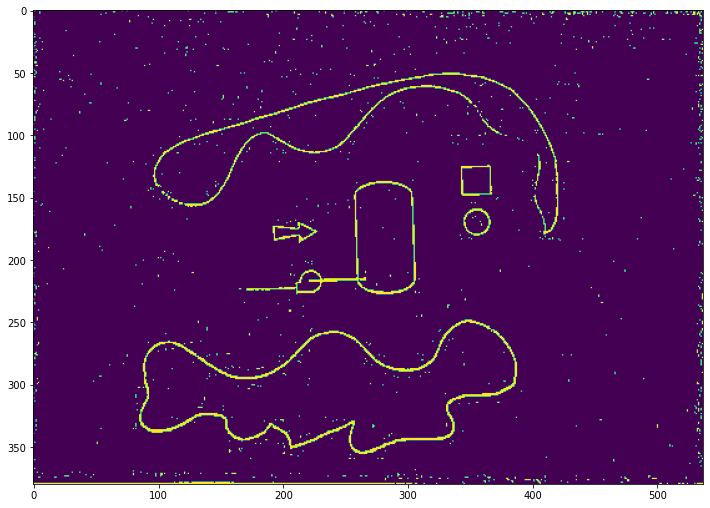

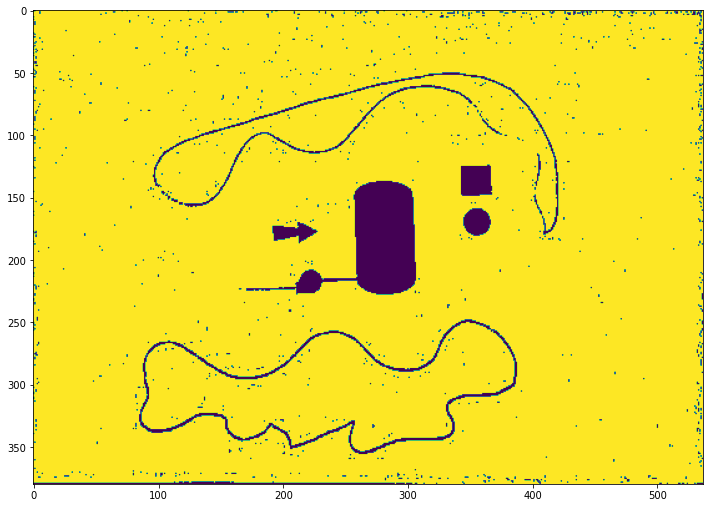

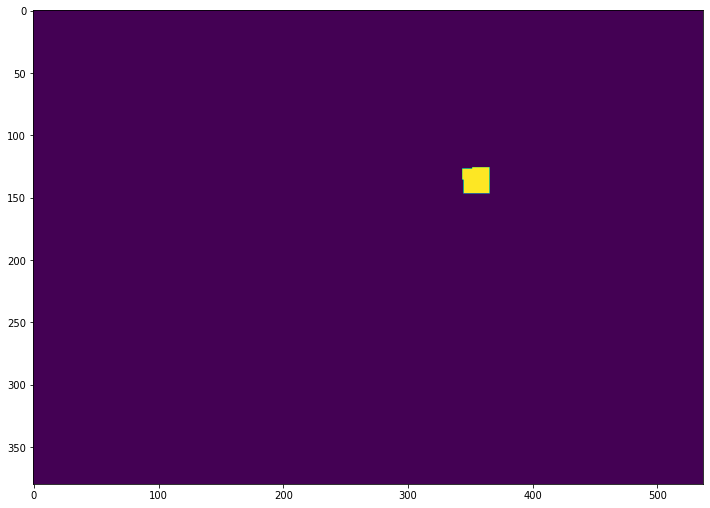

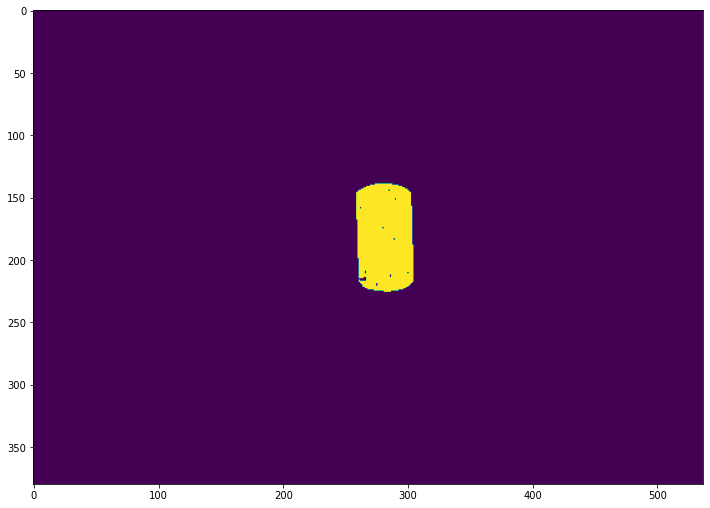

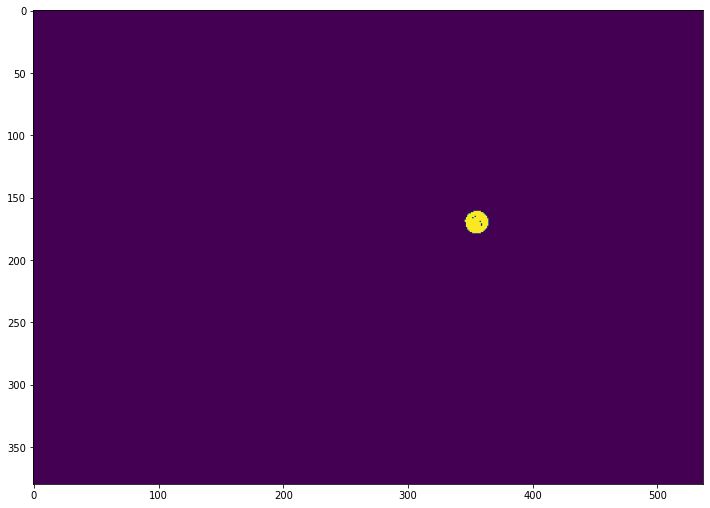

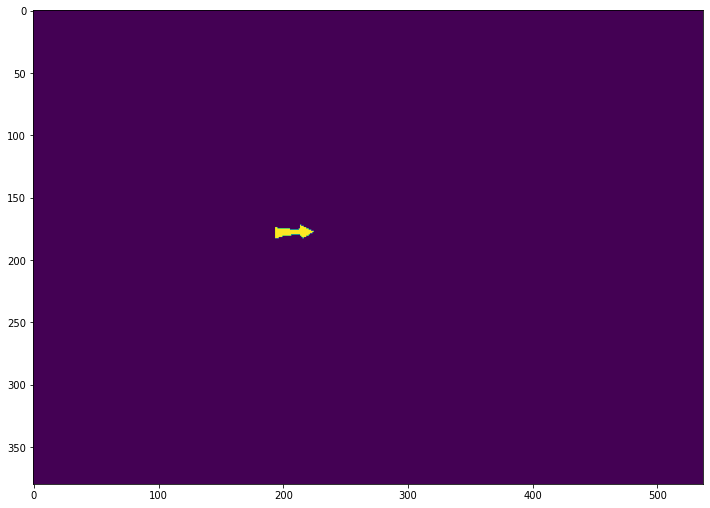

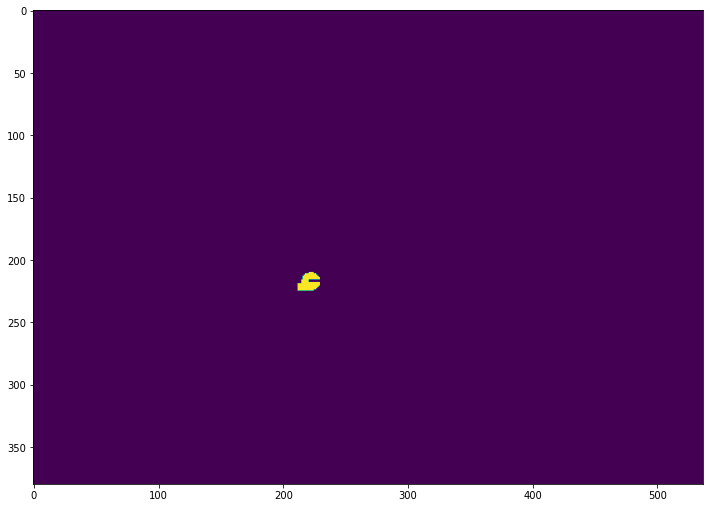

In [146]:
for label in np.unique(labels):
    connected = np.where(labels == label, 255, 0)
        

    plt.figure(figsize = (12,16))
    plt.imshow(connected)
    plt.show()

In [145]:
label = 2
labels == label

array([[False, False, False, ..., False, False, False],
       [False, False, False, ..., False, False, False],
       [False, False, False, ..., False, False, False],
       ...,
       [False, False, False, ..., False, False, False],
       [False, False, False, ..., False, False, False],
       [False, False, False, ..., False, False, False]])

In [148]:
np.unique(th3, return_counts=True)

(array([  0, 255], dtype=uint8), array([  6043, 198017], dtype=int64))

In [158]:
flippity = np.uint8(np.where(th3==255, 0, 255))

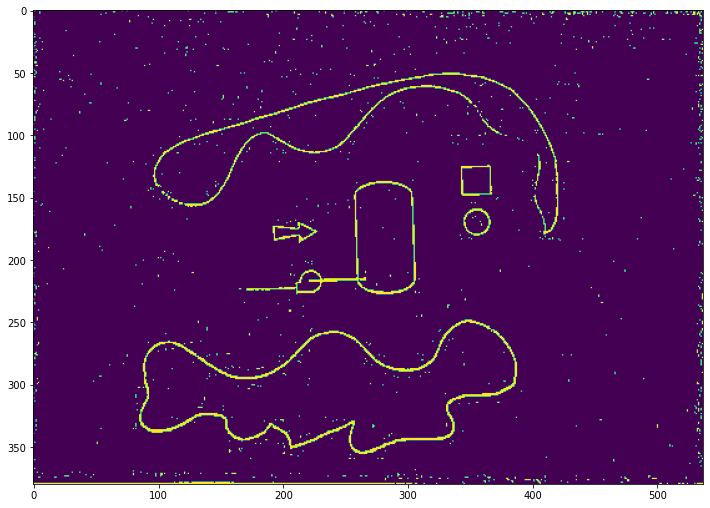

In [159]:
flippity

plt.figure(figsize = (12,16))
plt.imshow(flippity)
plt.show()

In [175]:
numLabels, labels, stats, centroids = cv2.connectedComponentsWithStats(flippity, connectivity=8)

In [176]:
numLabels

983

In [177]:
stats

array([[     0,      0,    537,    380, 198017],
       [     0,      0,      2,      1,      2],
       [     5,      1,      1,      2,      2],
       ...,
       [   524,    379,      1,      1,      1],
       [   530,    379,      1,      1,      1],
       [   532,    379,      5,      1,      5]], dtype=int32)

In [178]:
stats[0]

array([     0,      0,    537,    380, 198017], dtype=int32)

In [179]:
np.flip(np.sort(stats.T[-1]))

array([198017,   1776,    751,    687,    465,    331,    150,    131,
          112,     37,     29,     22,     11,     10,      9,      8,
            7,      7,      7,      7,      7,      7,      7,      7,
            6,      6,      6,      5,      5,      5,      5,      5,
            5,      5,      5,      5,      5,      5,      5,      5,
            5,      4,      4,      4,      4,      4,      4,      4,
            4,      4,      4,      4,      4,      4,      4,      4,
            4,      4,      4,      4,      4,      4,      4,      4,
            4,      4,      4,      3,      3,      3,      3,      3,
            3,      3,      3,      3,      3,      3,      3,      3,
            3,      3,      3,      3,      3,      3,      3,      3,
            3,      3,      3,      3,      3,      3,      3,      3,
            3,      3,      3,      3,      3,      3,      3,      3,
            3,      3,      3,      3,      3,      3,      3,      3,
      

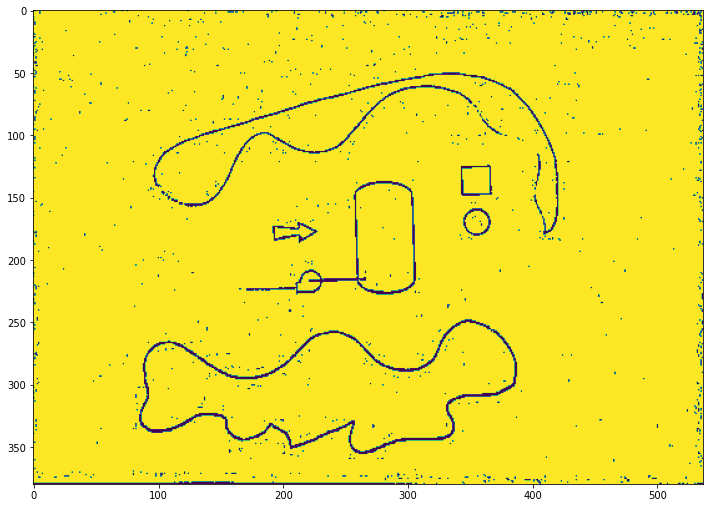

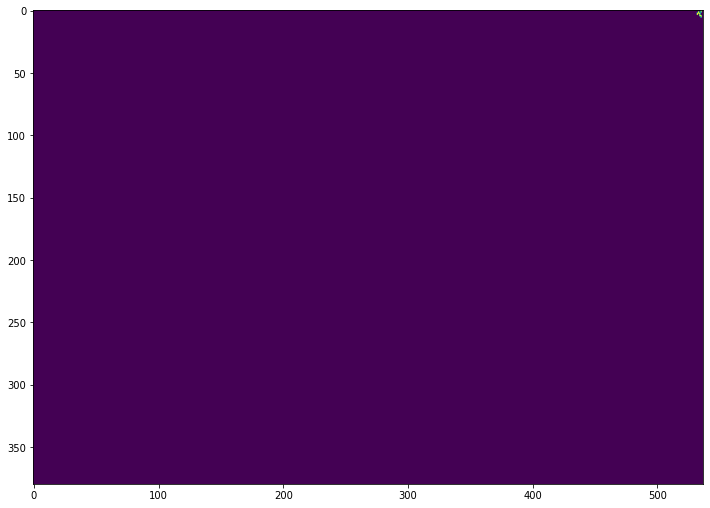

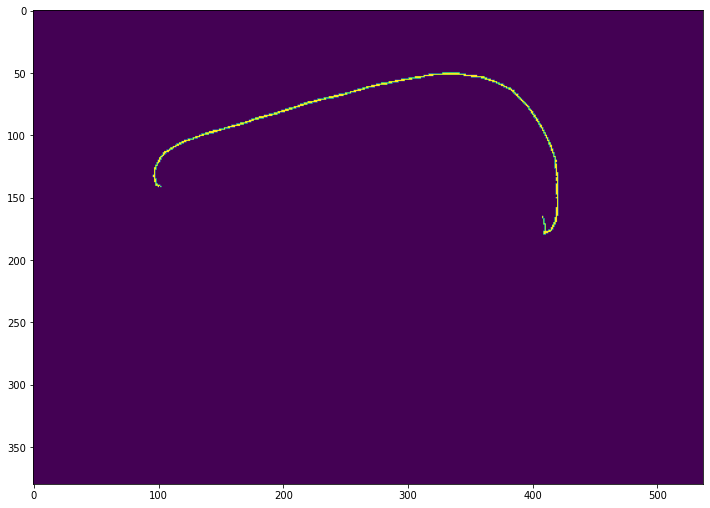

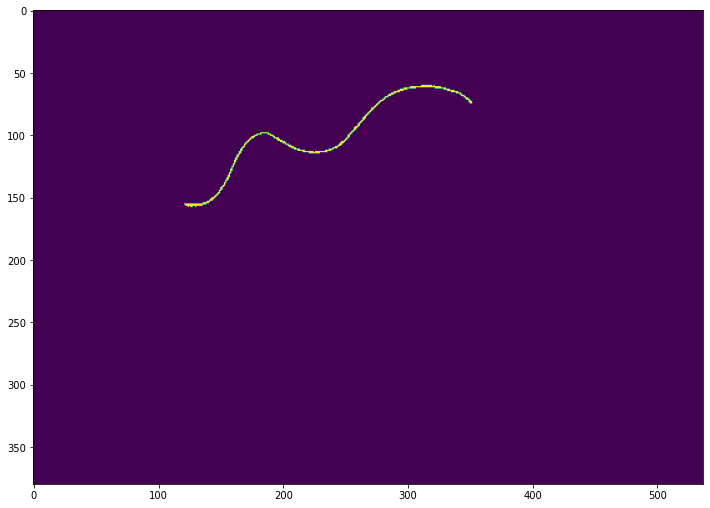

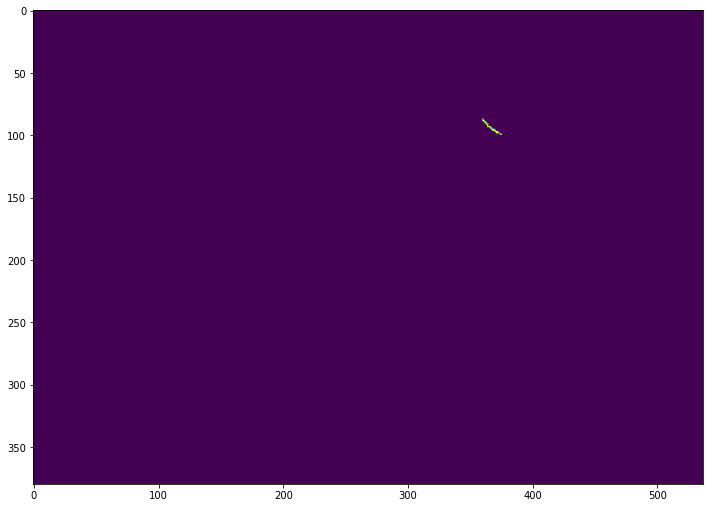

...

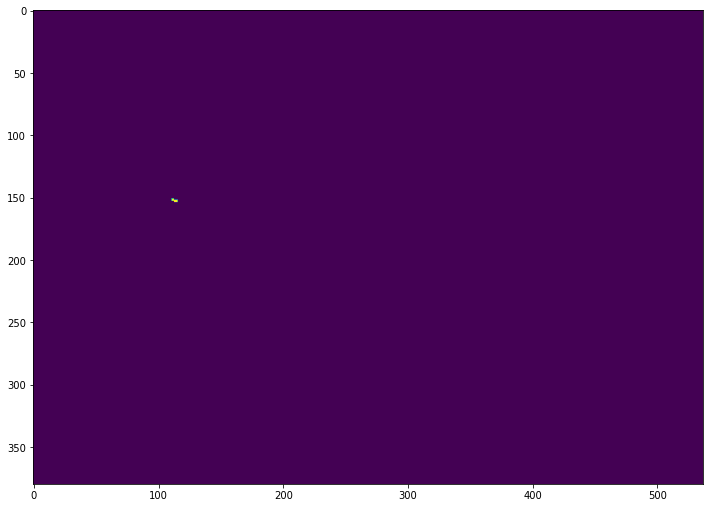

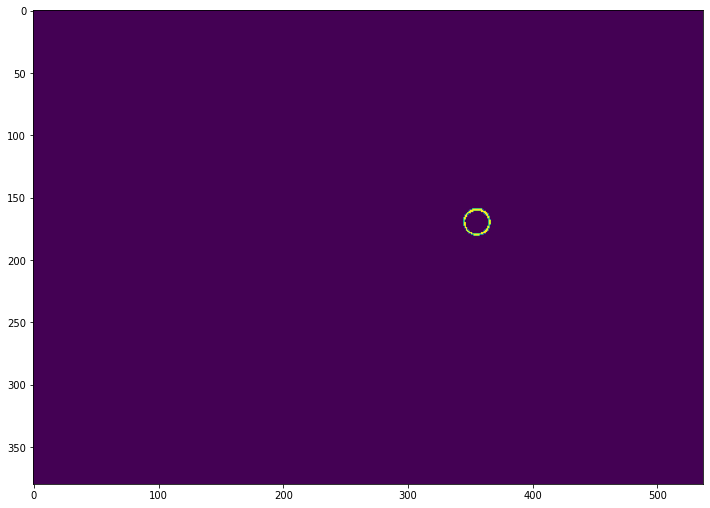

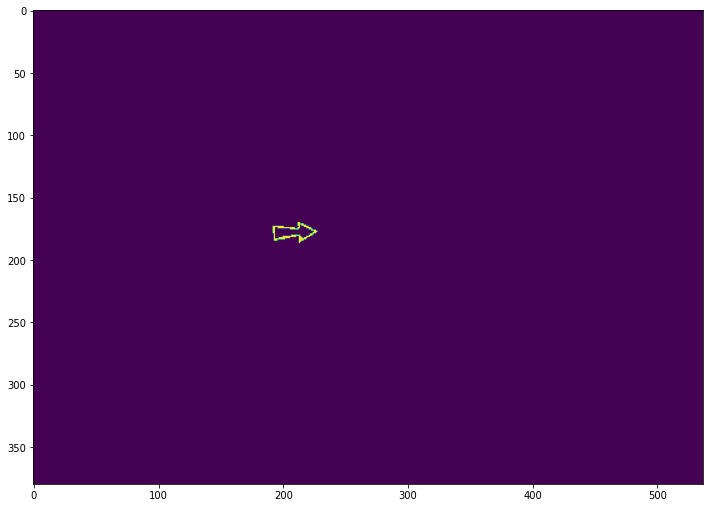

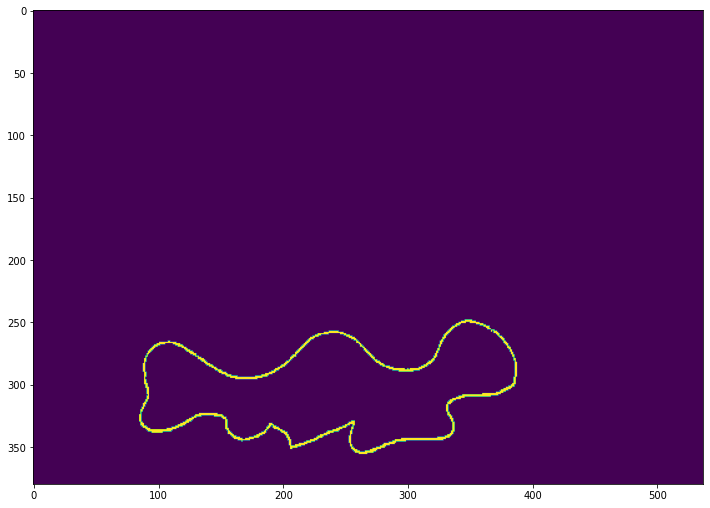

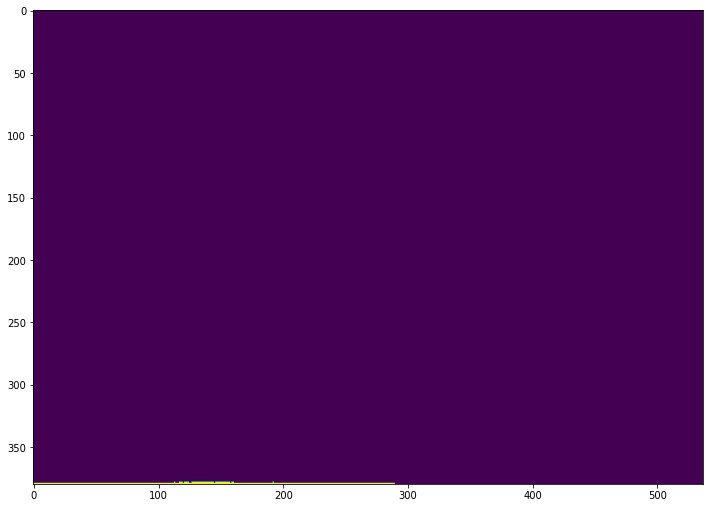

In [180]:
for label in np.unique(labels):
    if stats[label][-1] > 9:

        connected = np.where(labels == label, 255, 0)
            

        plt.figure(figsize = (12,16))
        plt.imshow(connected)
        plt.show()

In [ ]:
# https://medium.com/featurepreneur/dive-deeper-into-opencvs-adaptive-thresholding-3f29dda8c908